### Imports & Setup

In [3]:
# Imports & Setup
import os
import numpy as np
import pandas as pd
import SimpleITK as sitk
from scipy.ndimage import zoom, binary_fill_holes
import matplotlib.pyplot as plt
from pathlib import Path
import glob
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import jaccard_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.model_selection import train_test_split
import seaborn as sns
from skimage import morphology



In [8]:
# Define paths
SUBSET0_CT_DIR = "/kaggle/input/luna-16/Dataset/subset0/subset0/"
SUBSET0_GT_DIR = "/kaggle/input/luna-16/Dataset/seg-lungs-LUNA16/seg-lungs-LUNA16/"
PREPROCESSED_DIR = "/kaggle/working/luna16_subset0_preprocessed/"
PREDICTED_MASKS_DIR = "/kaggle/working/luna16_subset0_predicted_masks/"
ANNOTATIONS_FILE = "/kaggle/input/luna-16/Dataset/annotations.csv"
  

# Create directories
# Path(PREPROCESSED_DIR).mkdir(parents=True, exist_ok=True)
# Path(PREDICTED_MASKS_DIR).mkdir(parents=True, exist_ok=True)

# Define constants
TARGET_SLICE_SIZE = (256, 256)
TARGET_SPACING = 1.0
MIN_HU = -1000
MAX_HU = 400
BATCH_SIZE = 2
NUM_EPOCHS = 10
LEARNING_RATE = 1e-4
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

# Detection-specific constants
PATCH_SIZE = (32, 32, 32)
DETECTION_BATCH_SIZE = 16
DETECTION_NUM_EPOCHS = 20
 
DETECTION_LEARNING_RATE = 1e-3
POSITIVE_WEIGHT = 5.0

# Check if GPU is available
print(f"Using device: {DEVICE}")

# Get list of CT scans in subset0
ct_files = sorted(glob.glob(os.path.join(SUBSET0_CT_DIR, "*.mhd")))
print(f"Number of CT scans in subset0: {len(ct_files)}")

# Get list of all ground truth masks
gt_files_all = sorted(glob.glob(os.path.join(SUBSET0_GT_DIR, "*.mhd")))
print(f"Total number of ground truth masks (all subsets): {len(gt_files_all)}")


# Filter ground truth masks to only those corresponding to subset0 scans
ct_scan_ids = {os.path.basename(ct_file).replace(".mhd", "") for ct_file in ct_files}
gt_files = [gt_file for gt_file in gt_files_all if os.path.basename(gt_file).replace(".mhd", "") in ct_scan_ids]
print(f"Number of ground truth masks for subset0: {len(gt_files)}")

# Check for mismatch
if len(ct_files) != len(gt_files):
    raise ValueError(f"Mismatch between number of CT scans ({len(ct_files)}) and ground truth masks ({len(gt_files)}) for subset0!")


Using device: cpu
Number of CT scans in subset0: 89
Total number of ground truth masks (all subsets): 888
Number of ground truth masks for subset0: 89


### Preprocessing Functions

In [10]:
# Preprocessing Functions
def load_mhd(file_path):
    img = sitk.ReadImage(file_path)
    arr = sitk.GetArrayFromImage(img)
    spacing = np.array(img.GetSpacing())[::-1]  # Reverse to match array dimensions (z, y, x)
    return arr, spacing

def resample_isotropic(arr, spacing, target_spacing=1.0, order=3):
    zoom_factors = spacing / target_spacing
    return zoom(arr, zoom_factors, order=order)

def normalize_hu(arr):
    arr = np.clip(arr, MIN_HU, MAX_HU)
    arr = (arr - MIN_HU) / (MAX_HU - MIN_HU)
    return arr

def extract_2d_slices(ct_arr, gt_arr, target_size=(256, 256)):
    slices = []
    for z in range(ct_arr.shape[0]):
        ct_slice = ct_arr[z]
        gt_slice = gt_arr[z]
        if ct_slice.shape != target_size:
            ct_slice = zoom(ct_slice, (target_size[0]/ct_slice.shape[0], target_size[1]/ct_slice.shape[1]), order=3)
            gt_slice = zoom(gt_slice, (target_size[0]/gt_slice.shape[0], target_size[1]/gt_slice.shape[1]), order=0)
        slices.append((ct_slice, gt_slice))
    return slices

def visualize_sample(ct_slice, gt_slice):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(ct_slice, cmap='gray')
    ax[0].set_title("CT Slice")
    ax[0].axis('off')
    ax[1].imshow(gt_slice, cmap='gray')
    ax[1].set_title("Ground Truth Mask")
    ax[1].axis('off')
    plt.tight_layout()
    plt.show()

def preprocess_luna16_subset0(ct_dir, gt_dir, output_dir, max_scans=None):
    """Preprocess all CT scans in subset0 for U-Net training"""
    ct_files = sorted(glob.glob(os.path.join(ct_dir, "*.mhd")))
    if max_scans is not None:
        ct_files = ct_files[:max_scans]
    print(f"Processing {len(ct_files)} CT scans from {ct_dir}")

    all_slices = []
    for ct_path in ct_files:
        scan_id = os.path.basename(ct_path).replace(".mhd", "")
        gt_path = os.path.join(gt_dir, f"{scan_id}.mhd")

        # 1. Load CT and ground truth
        print(f"\nProcessing scan: {scan_id}")
        try:
            ct_arr, spacing = load_mhd(ct_path)
            gt_arr, _ = load_mhd(gt_path)
            gt_arr = (gt_arr > 0).astype(np.uint8)
        except Exception as e:
            print(f"Error loading scan {scan_id}: {str(e)}")
            continue

        # 2. Resample to isotropic spacing
        ct_resampled = resample_isotropic(ct_arr, spacing, target_spacing=TARGET_SPACING, order=3)
        gt_resampled = resample_isotropic(gt_arr, spacing, target_spacing=TARGET_SPACING, order=0)

        # 3. Normalize CT
        ct_normalized = normalize_hu(ct_resampled)

        # 4. Extract 2D slices
        slices = extract_2d_slices(ct_normalized, gt_resampled, target_size=TARGET_SLICE_SIZE)
        if not slices:
            print(f"No valid slices found for scan {scan_id}, skipping...")
            continue

        # 5. Visualize a sample slice
        if len(slices) > 0:
            print(f"Visualizing a sample slice from scan {scan_id}...")
            visualize_sample(slices[len(slices)//2][0], slices[len(slices)//2][1])

        # 6. Save the slices as .npz
        os.makedirs(os.path.join(output_dir, "ct_slices"), exist_ok=True)
        os.makedirs(os.path.join(output_dir, "gt_slices"), exist_ok=True)
        for idx, (ct_slice, gt_slice) in enumerate(slices):
            slice_id = f"{scan_id}_slice_{idx:03d}"
            np.savez_compressed(os.path.join(output_dir, "ct_slices", f"{slice_id}.npz"), data=ct_slice)
            np.savez_compressed(os.path.join(output_dir, "gt_slices", f"{slice_id}.npz"), data=gt_slice)
            all_slices.append((slice_id, ct_path, gt_path))

        print(f"Total slices extracted for scan {scan_id}: {len(slices)}")

    print(f"\nPreprocessing complete! Total number of slices extracted: {len(all_slices)}")
    return all_slices

### Preprocessing


Step 1: Preprocessing data...
Processing 89 CT scans from /kaggle/input/luna-16/Dataset/subset0/subset0/

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260...


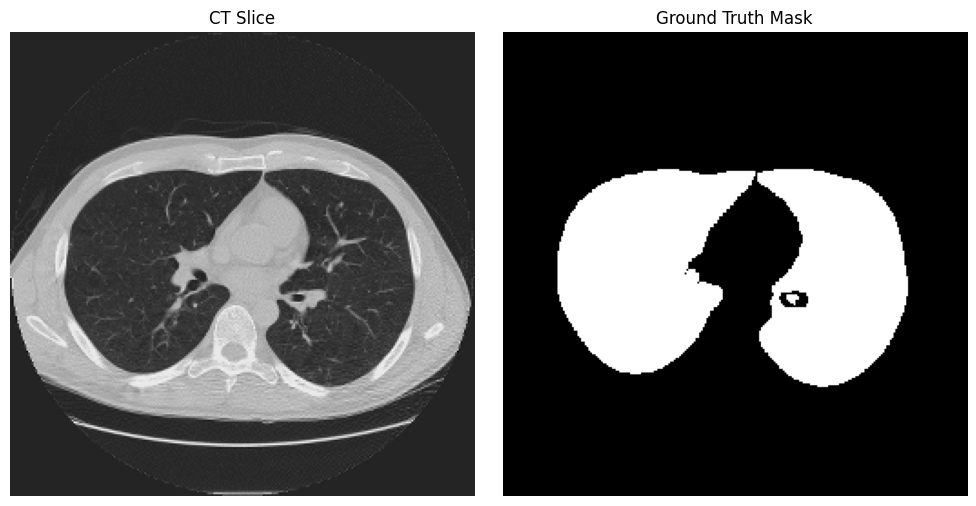

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260: 302

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492...


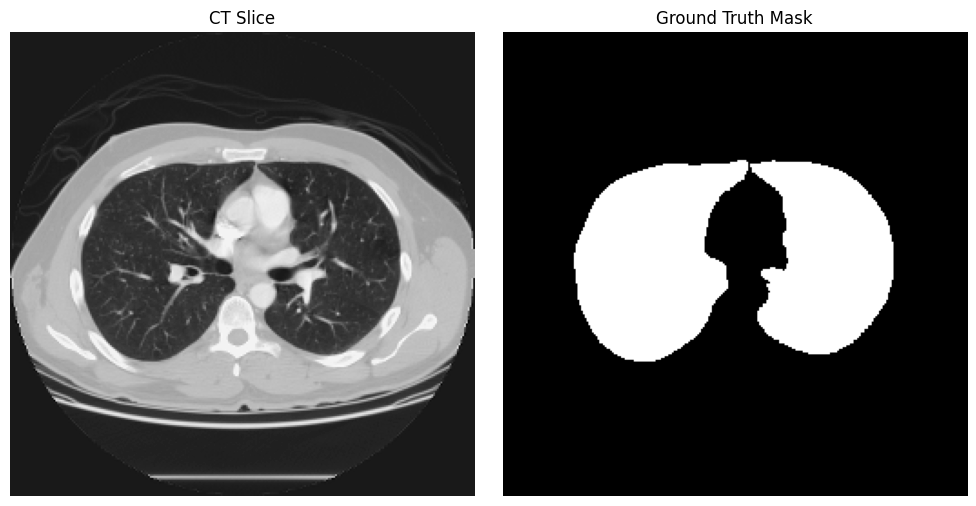

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492: 298

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059...


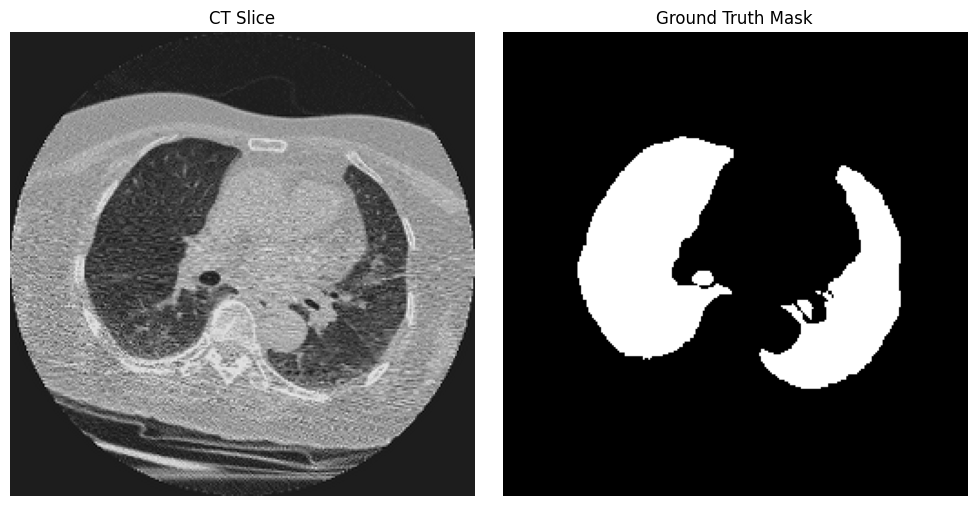

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059: 201

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674661221381920536987
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674661221381920536987...


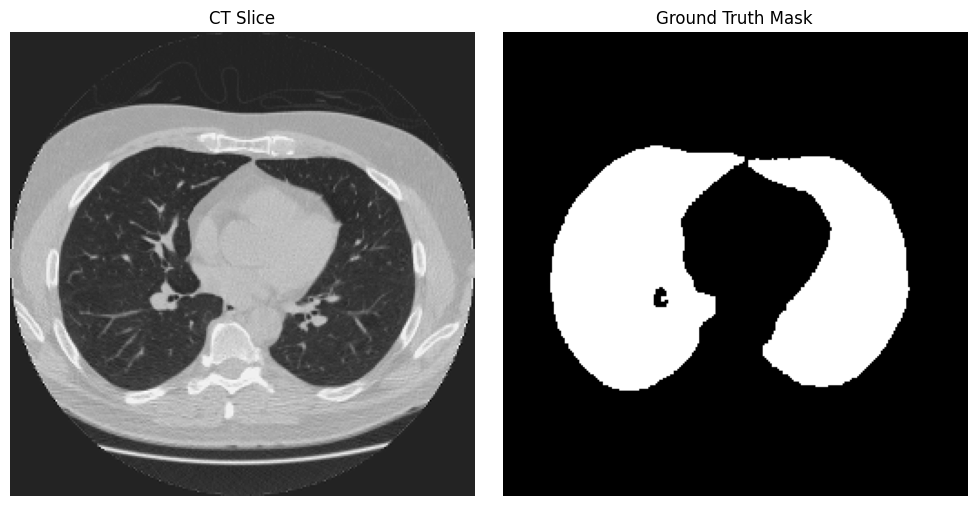

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674661221381920536987: 336

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.122763913896761494371822656720
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.122763913896761494371822656720...


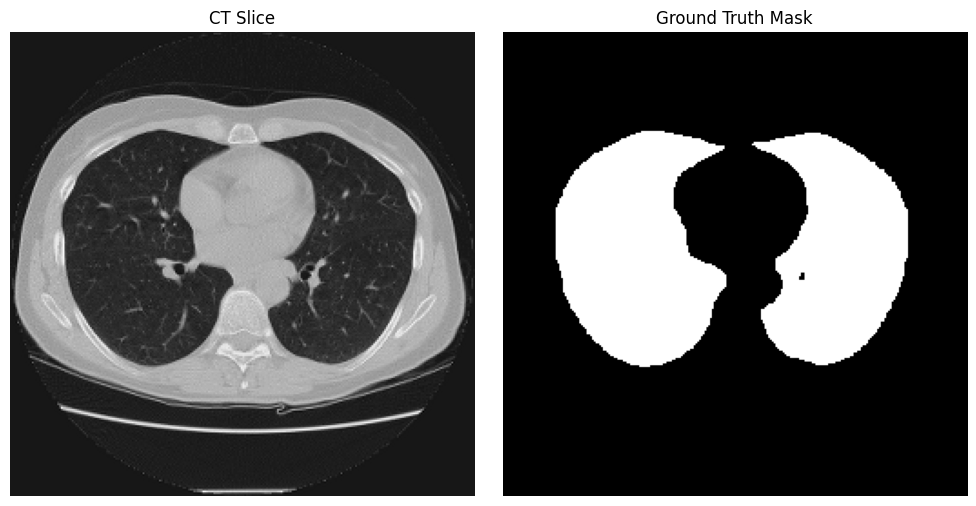

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.122763913896761494371822656720: 310

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048929153767743874565
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048929153767743874565...


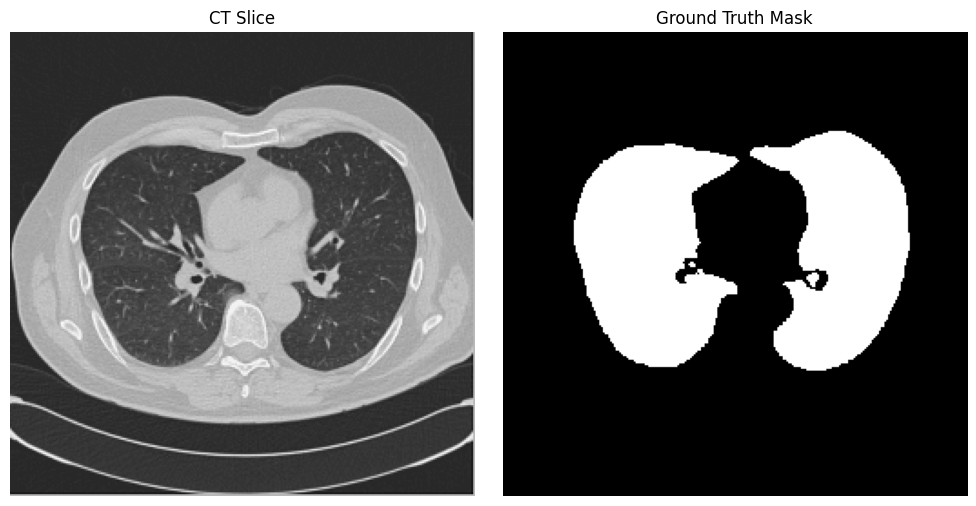

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048929153767743874565: 351

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.126121460017257137098781143514
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.126121460017257137098781143514...


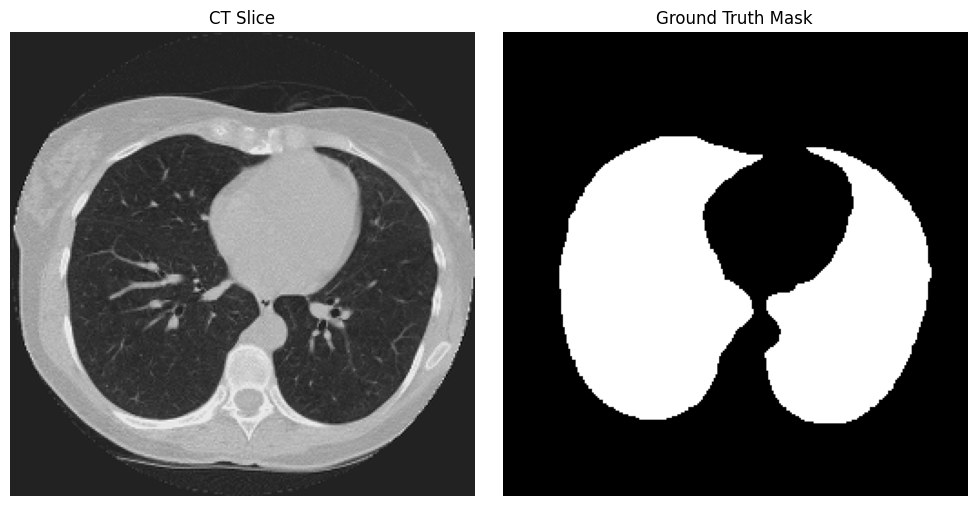

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.126121460017257137098781143514: 332

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.126264578931778258890371755354
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.126264578931778258890371755354...


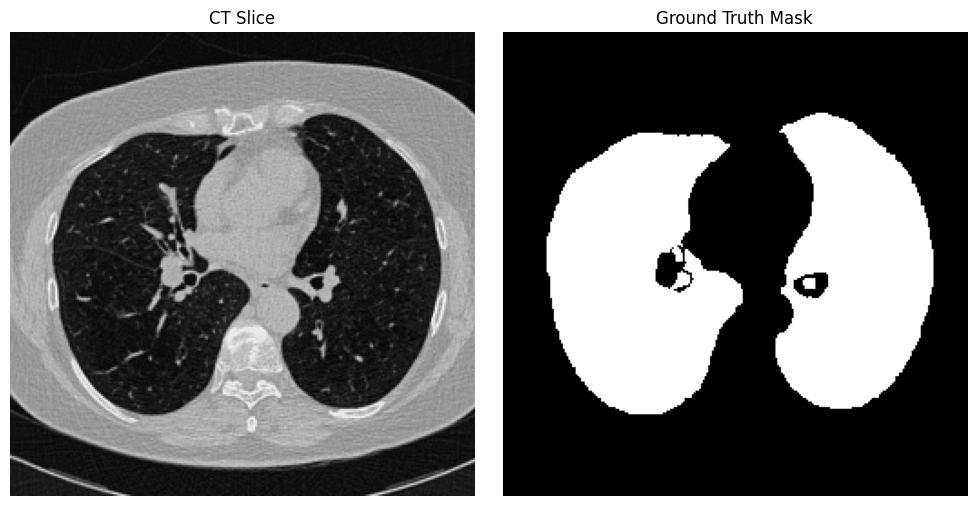

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.126264578931778258890371755354: 336

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.128023902651233986592378348912
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.128023902651233986592378348912...


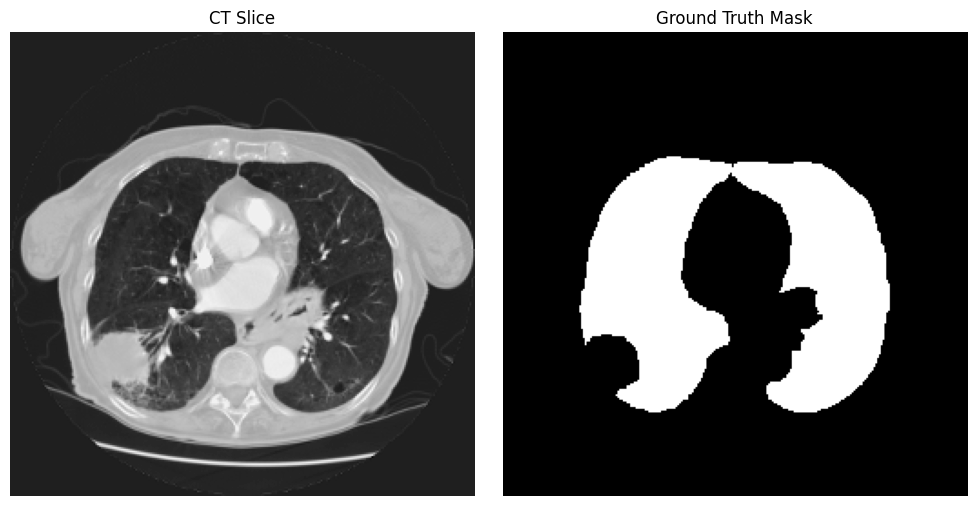

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.128023902651233986592378348912: 332

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.129055977637338639741695800950
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.129055977637338639741695800950...


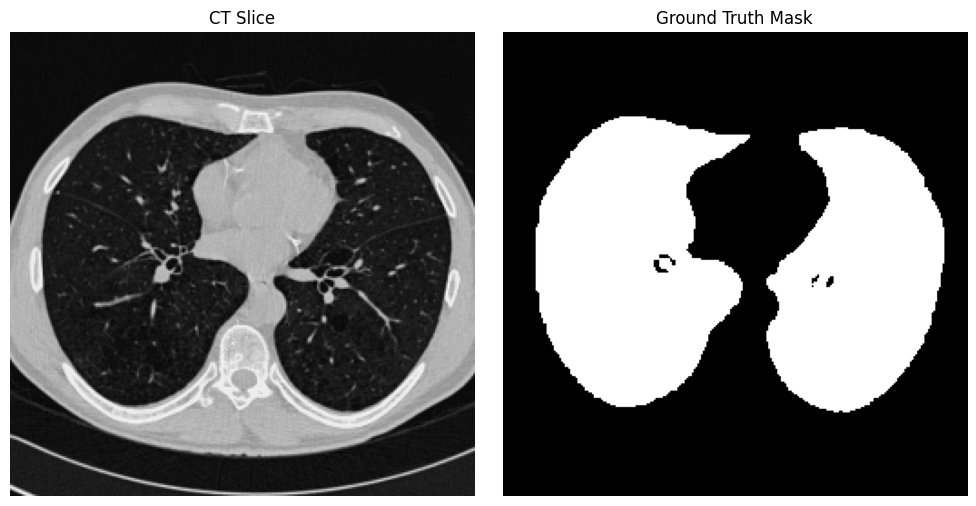

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.129055977637338639741695800950: 338

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.130438550890816550994739120843
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.130438550890816550994739120843...


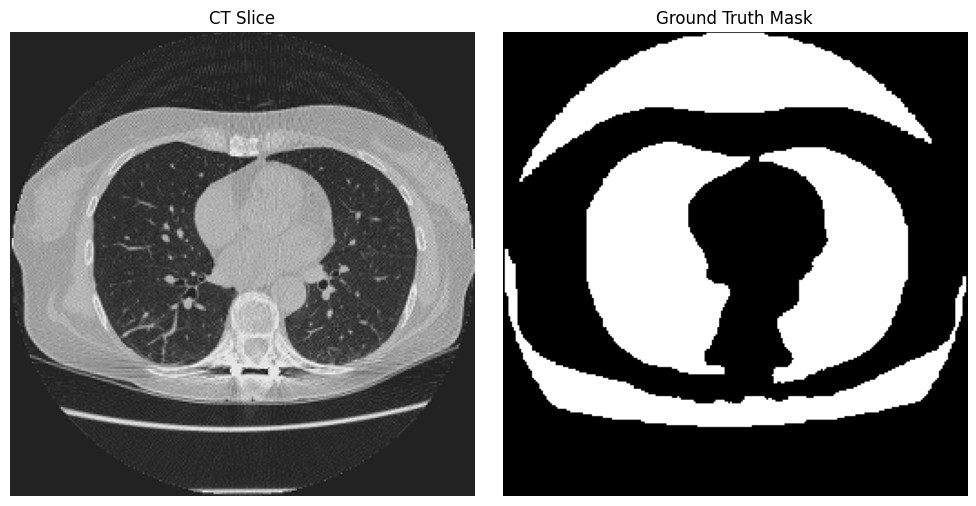

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.130438550890816550994739120843: 342

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.134996872583497382954024478441
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.134996872583497382954024478441...


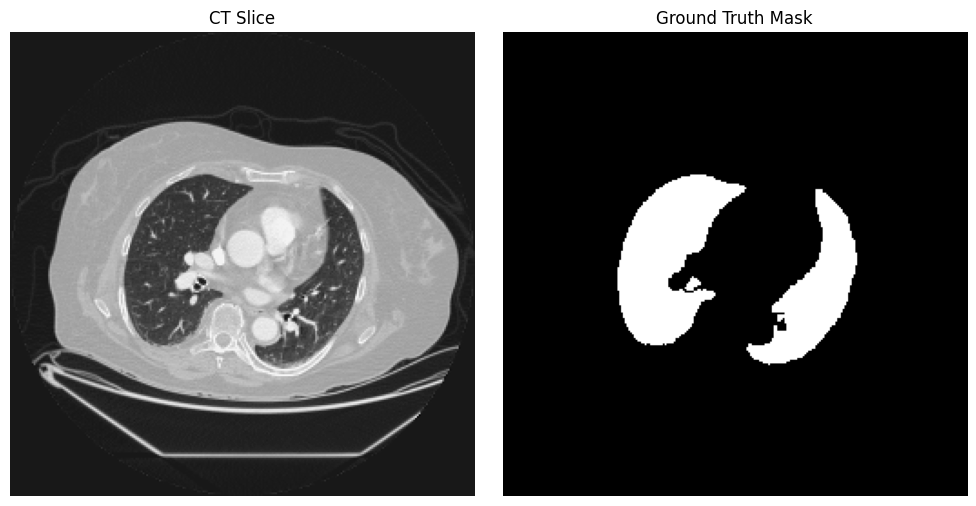

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.134996872583497382954024478441: 246

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.137763212752154081977261297097
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.137763212752154081977261297097...


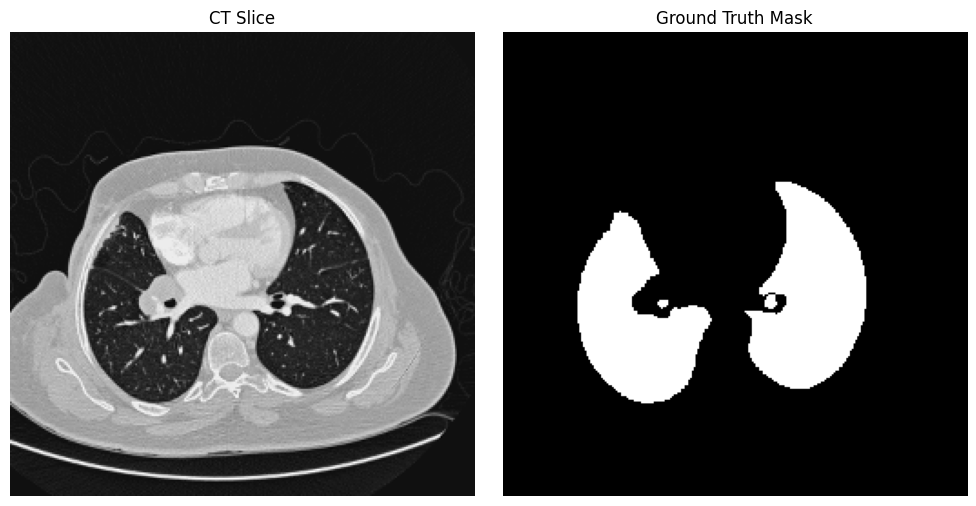

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.137763212752154081977261297097: 246

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.138080888843357047811238713686
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.138080888843357047811238713686...


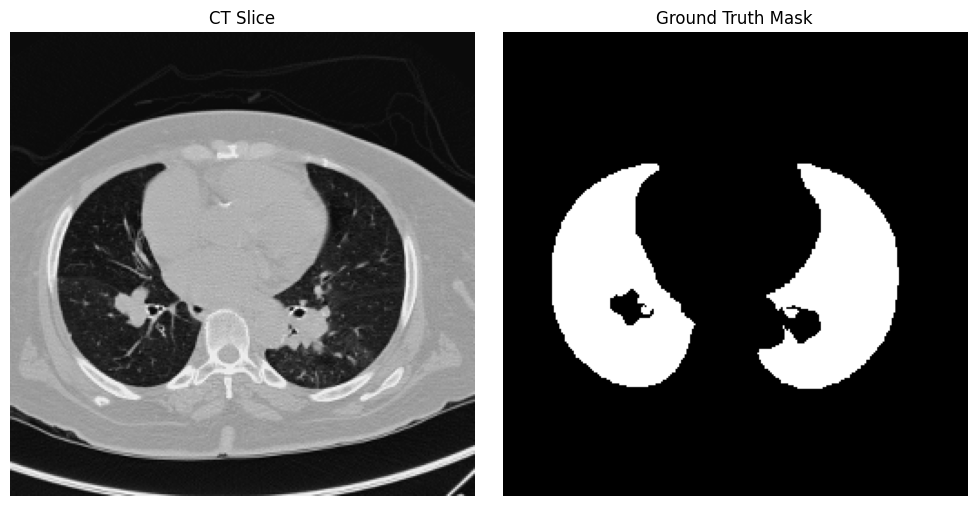

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.138080888843357047811238713686: 295

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.139258777898746693365877042411
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.139258777898746693365877042411...


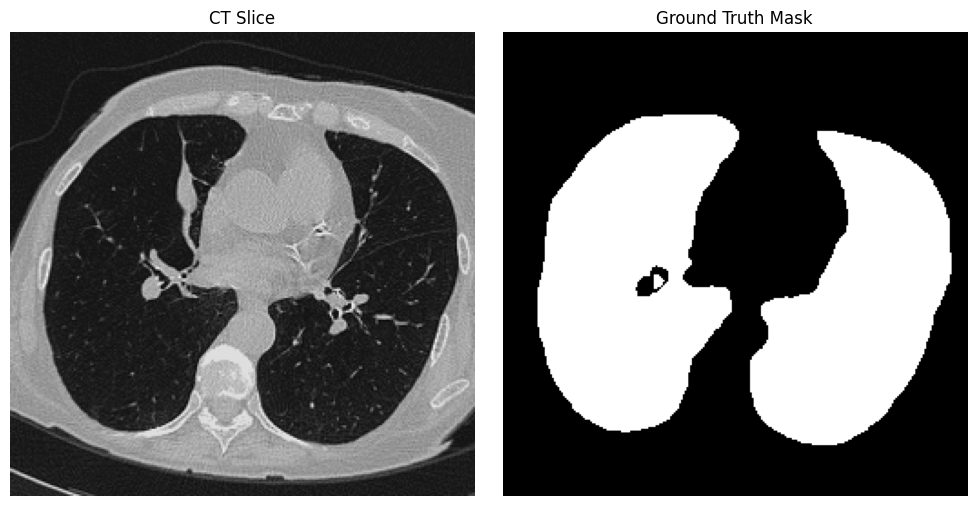

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.139258777898746693365877042411: 294

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.139713436241461669335487719526
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.139713436241461669335487719526...


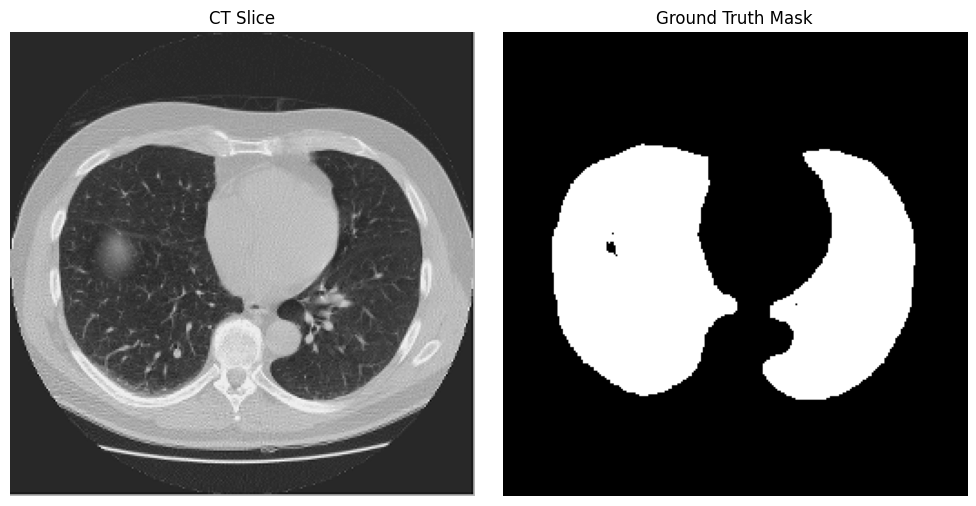

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.139713436241461669335487719526: 350

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.141069661700670042960678408762
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.141069661700670042960678408762...


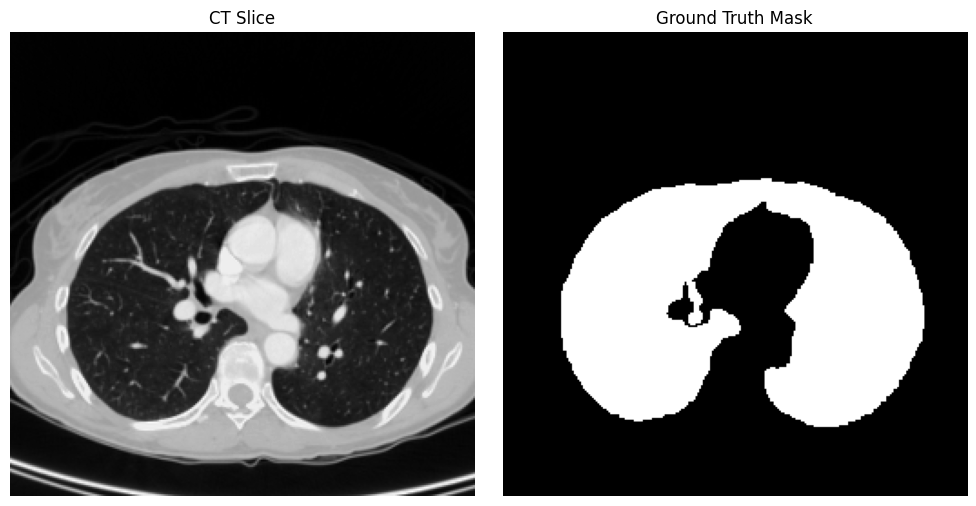

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.141069661700670042960678408762: 280

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.144438612068946916340281098509
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.144438612068946916340281098509...


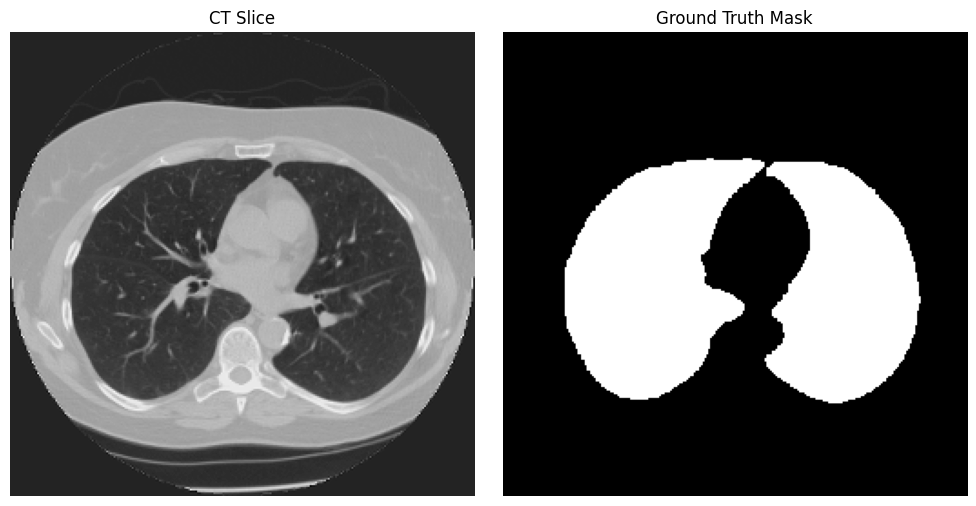

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.144438612068946916340281098509: 314

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.146429221666426688999739595820
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.146429221666426688999739595820...


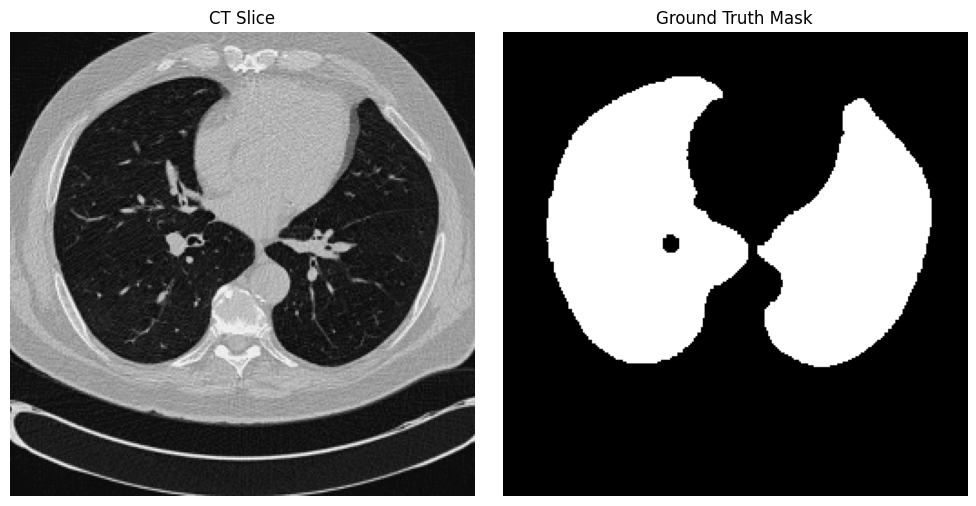

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.146429221666426688999739595820: 365

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.154677396354641150280013275227
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.154677396354641150280013275227...


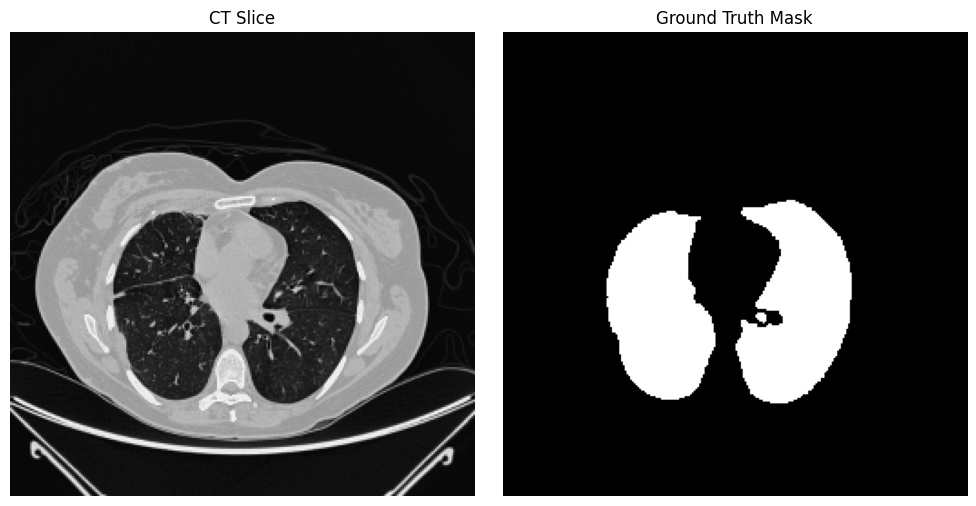

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.154677396354641150280013275227: 275

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.187451715205085403623595258748
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.187451715205085403623595258748...


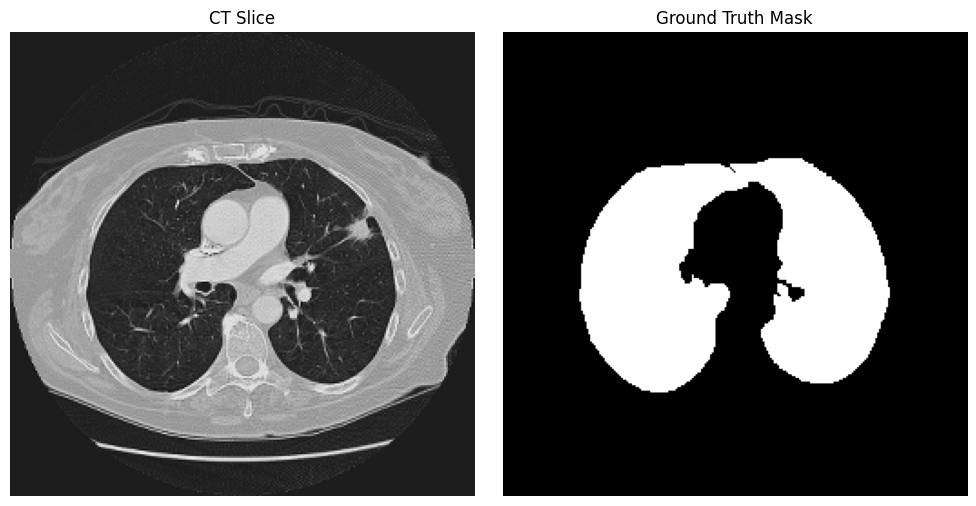

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.187451715205085403623595258748: 312

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.188209889686363159853715266493
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.188209889686363159853715266493...


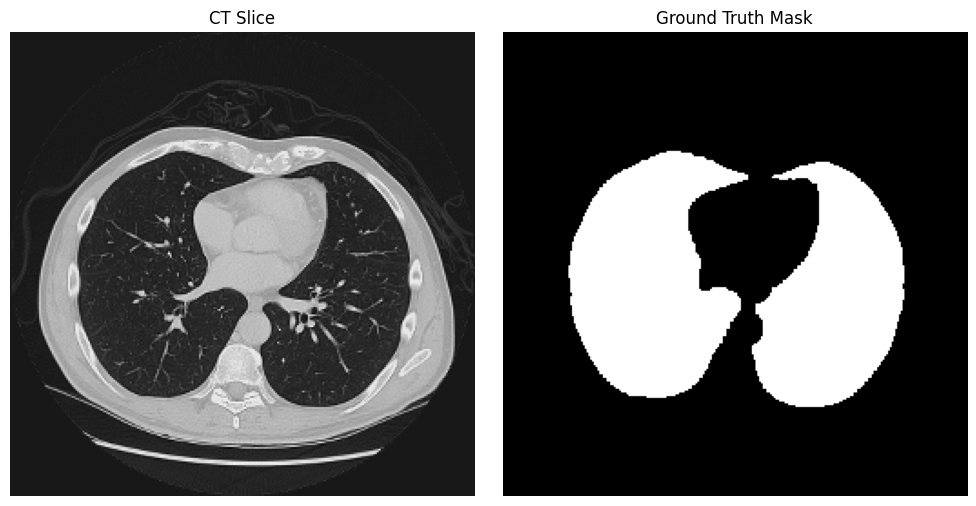

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.188209889686363159853715266493: 368

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.188376349804761988217597754952
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.188376349804761988217597754952...


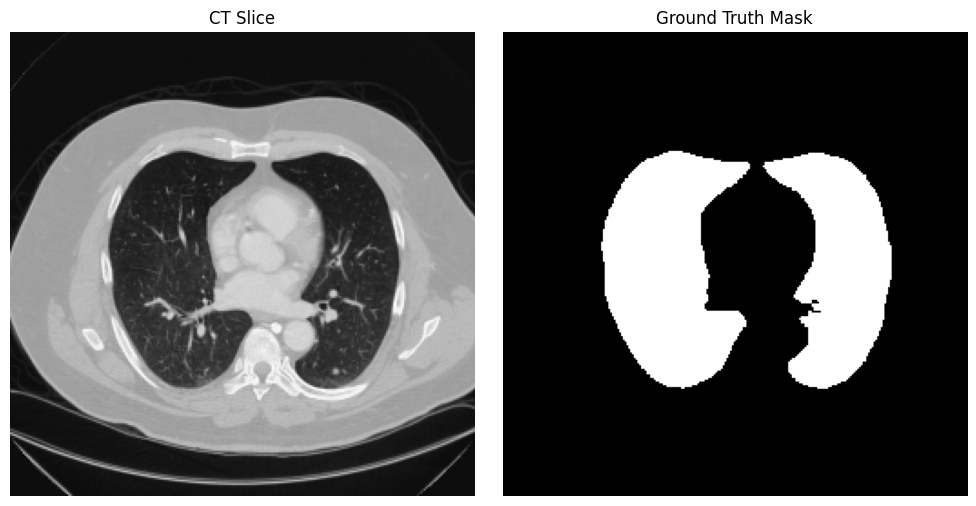

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.188376349804761988217597754952: 245

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.194440094986948071643661798326
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.194440094986948071643661798326...


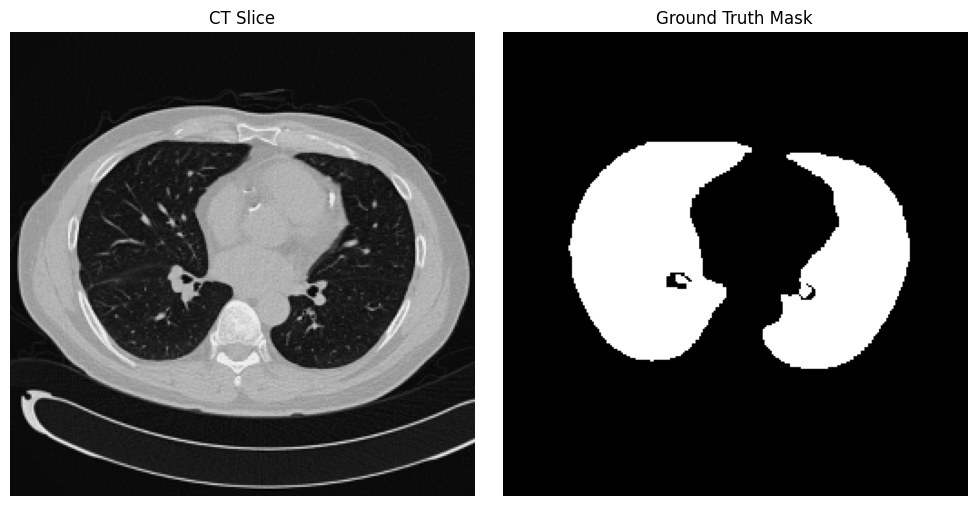

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.194440094986948071643661798326: 351

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.194465340552956447447896167830
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.194465340552956447447896167830...


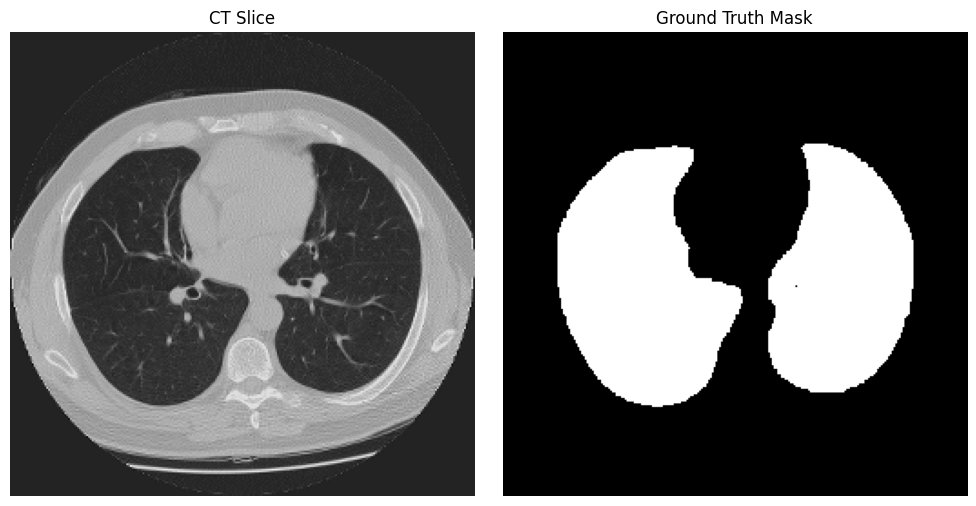

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.194465340552956447447896167830: 322

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.202811684116768680758082619196
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.202811684116768680758082619196...


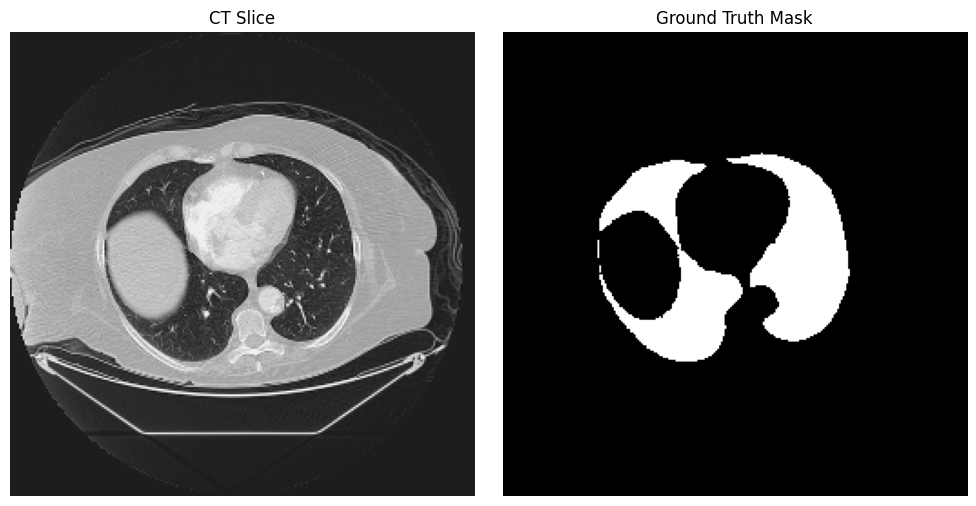

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.202811684116768680758082619196: 332

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.210837812047373739447725050963
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.210837812047373739447725050963...


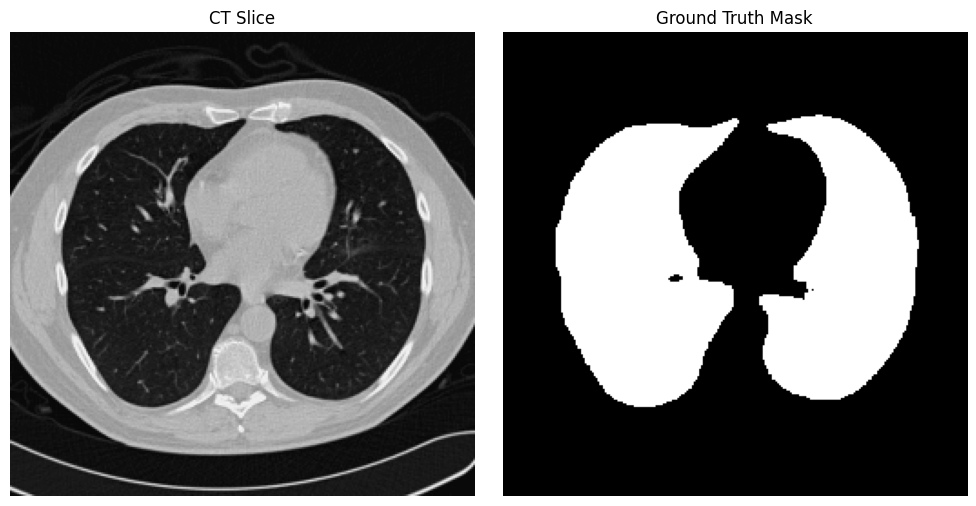

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.210837812047373739447725050963: 349

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.213140617640021803112060161074
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.213140617640021803112060161074...


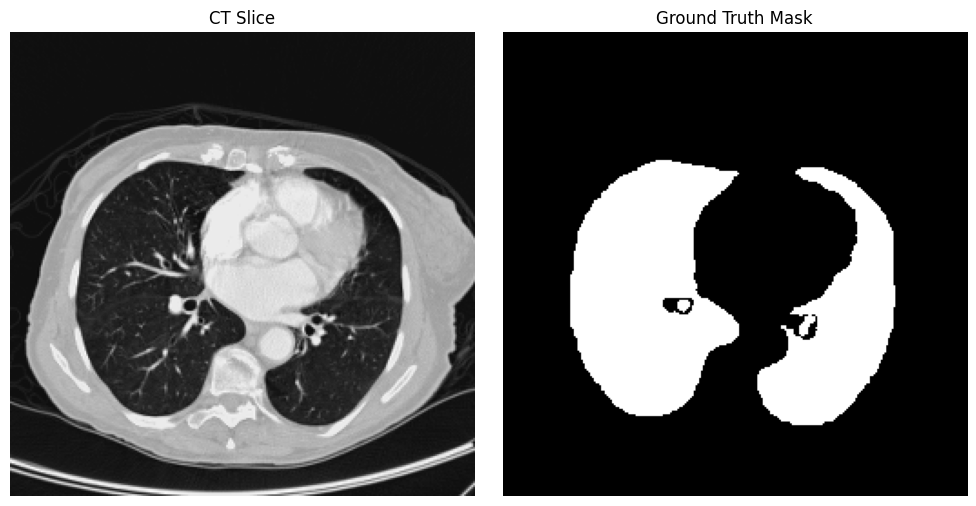

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.213140617640021803112060161074: 276

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.216882370221919561230873289517
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.216882370221919561230873289517...


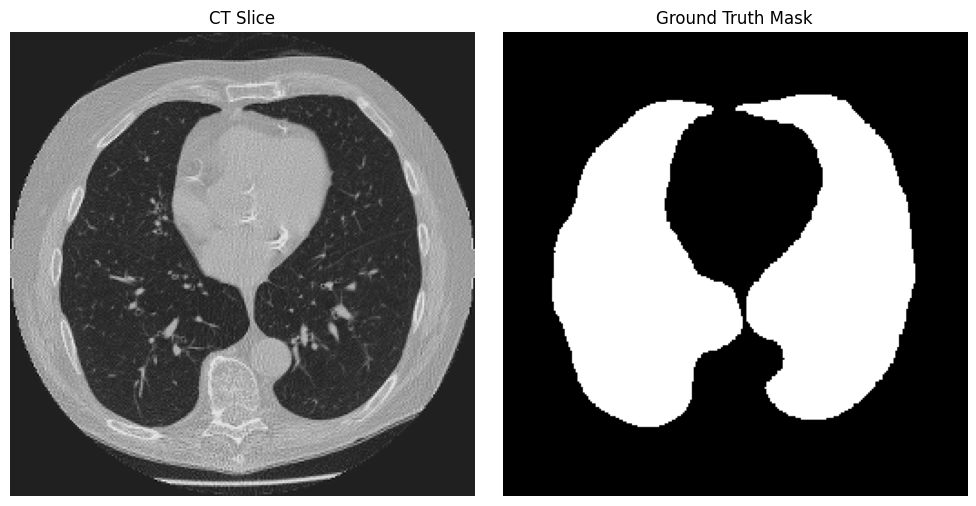

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.216882370221919561230873289517: 312

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.219087313261026510628926082729
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.219087313261026510628926082729...


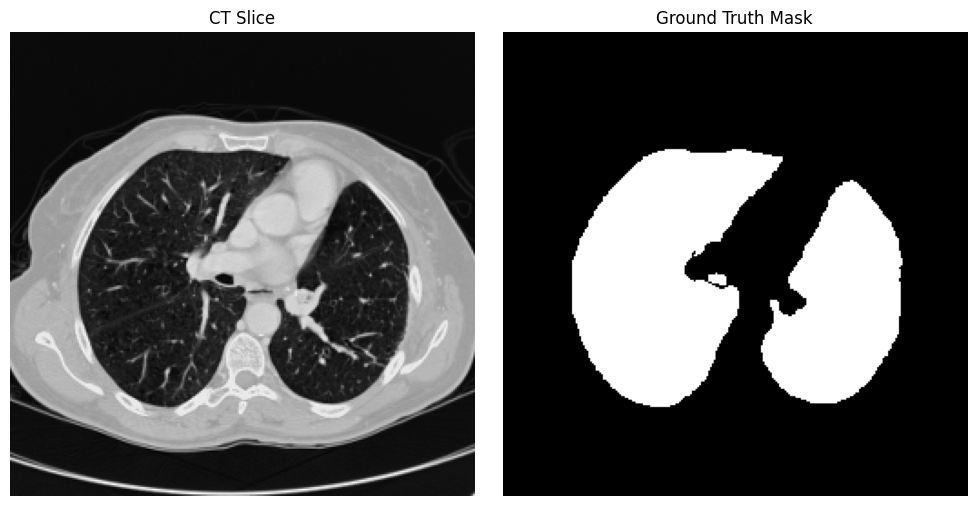

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.219087313261026510628926082729: 280

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.219909753224298157409438012179
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.219909753224298157409438012179...


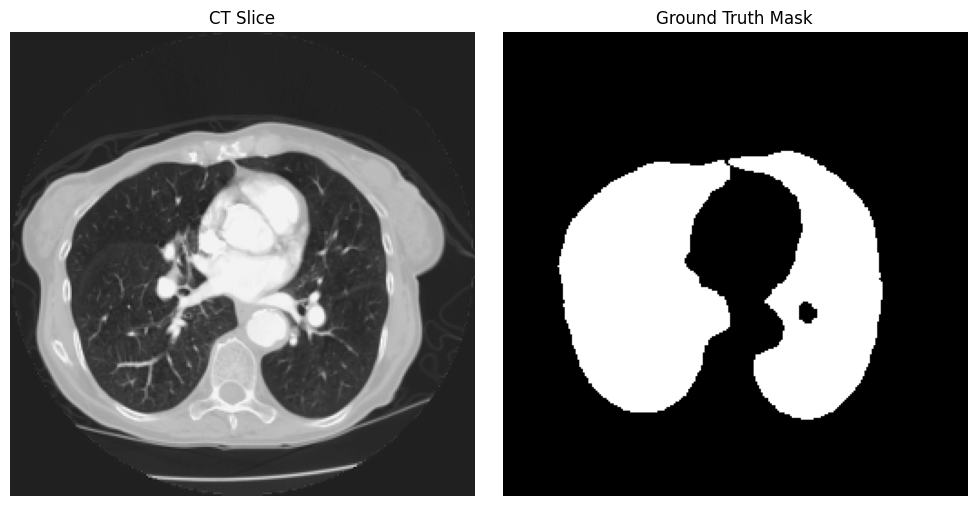

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.219909753224298157409438012179: 352

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.227962600322799211676960828223
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.227962600322799211676960828223...


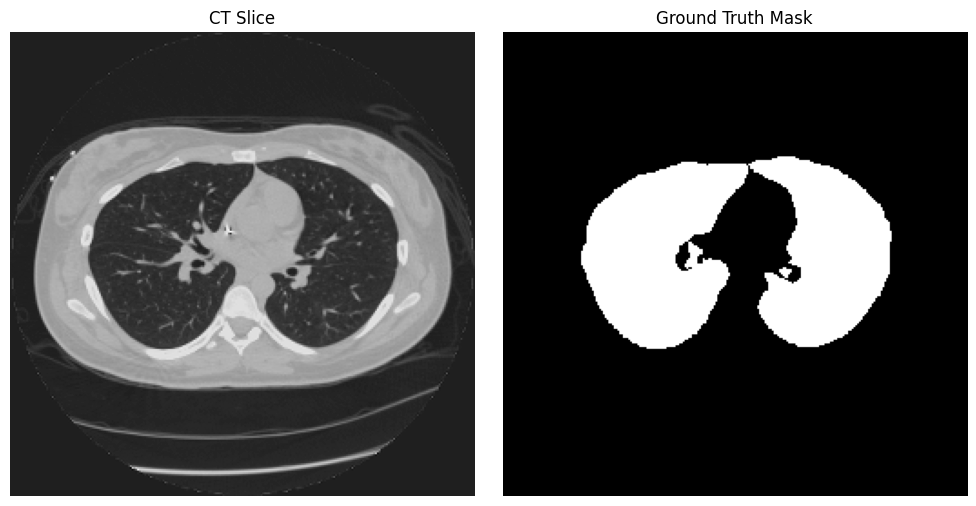

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.227962600322799211676960828223: 261

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.231645134739451754302647733304
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.231645134739451754302647733304...


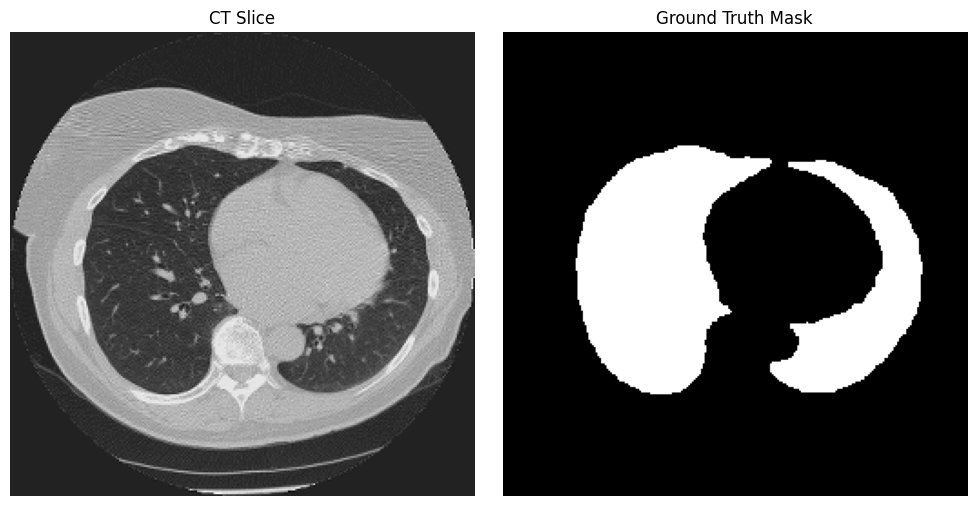

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.231645134739451754302647733304: 319

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.238522526736091851696274044574
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.238522526736091851696274044574...


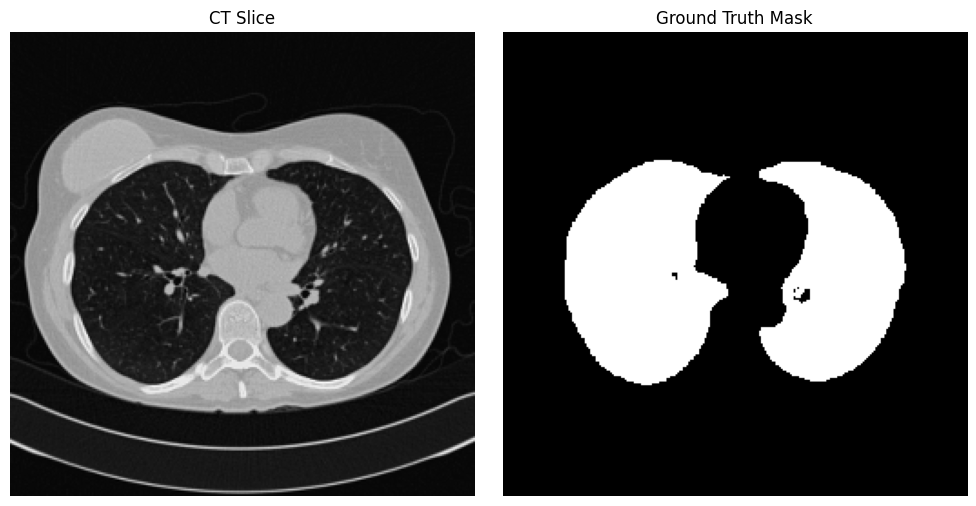

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.238522526736091851696274044574: 329

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.241570579760883349458693655367
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.241570579760883349458693655367...


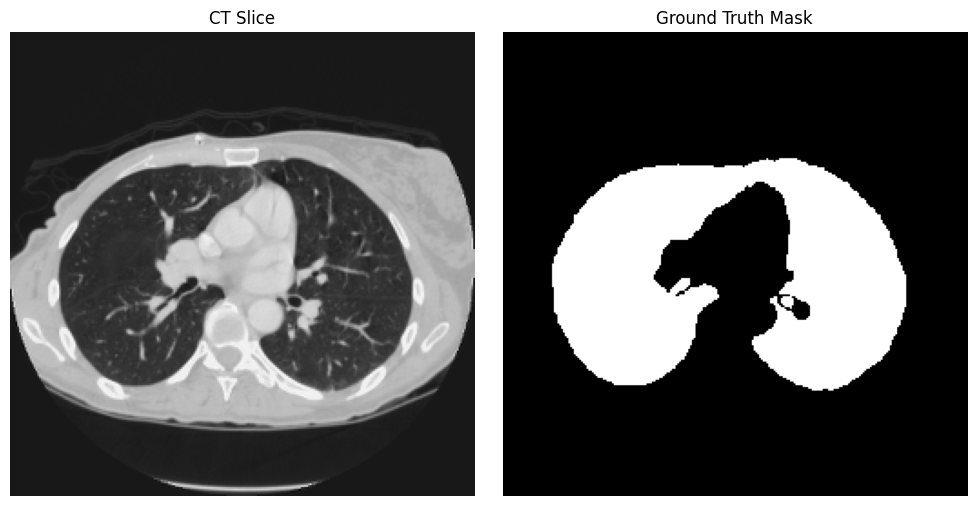

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.241570579760883349458693655367: 325

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.249530219848512542668813996730
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.249530219848512542668813996730...


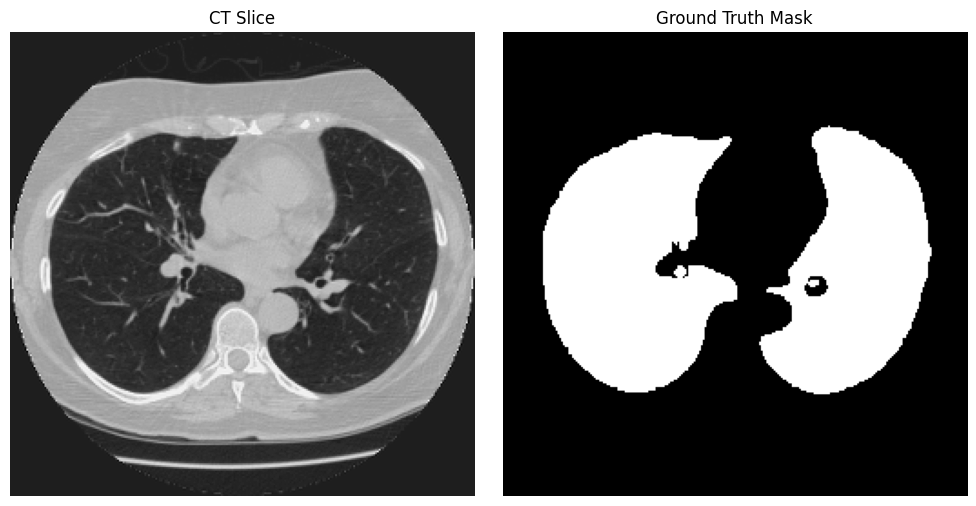

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.249530219848512542668813996730: 301

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.250438451287314206124484591986
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.250438451287314206124484591986...


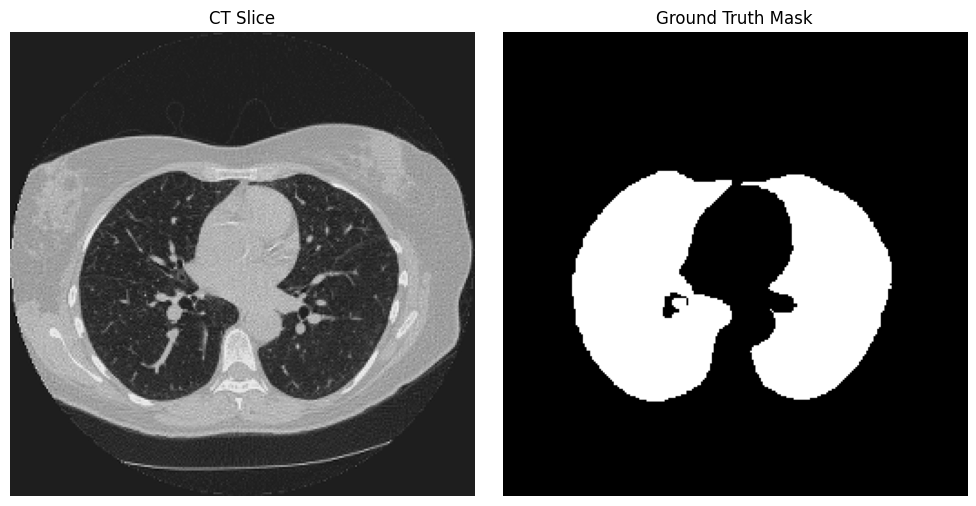

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.250438451287314206124484591986: 276

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.250863365157630276148828903732
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.250863365157630276148828903732...


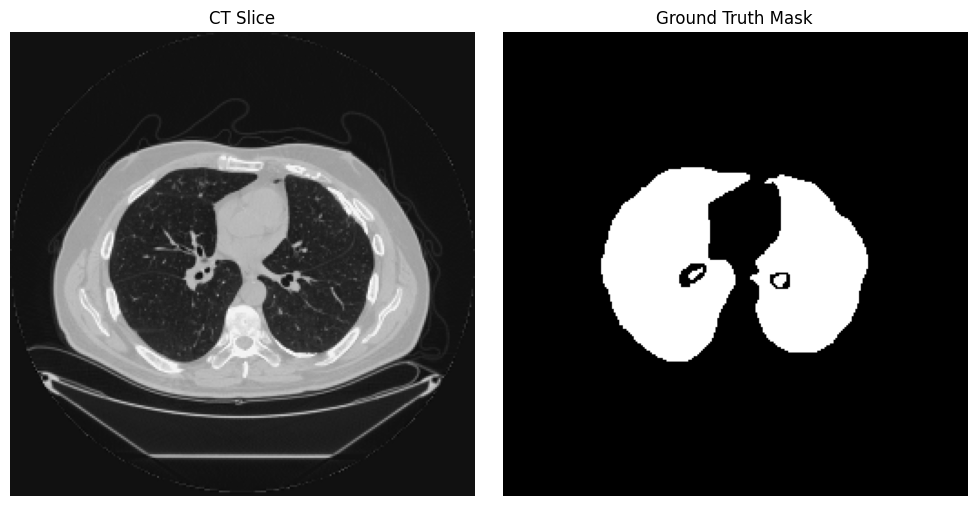

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.250863365157630276148828903732: 371

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.269689294231892620436462818860
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.269689294231892620436462818860...


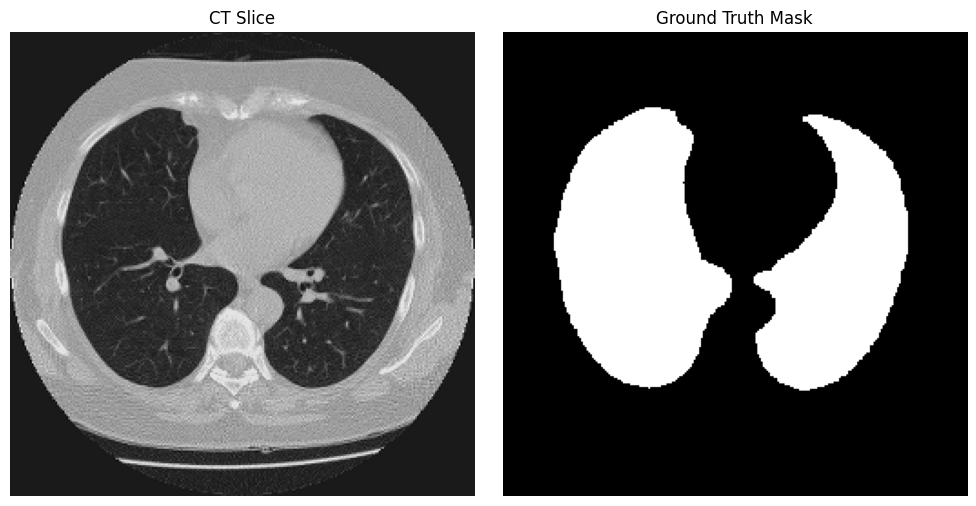

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.269689294231892620436462818860: 308

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.272042302501586336192628818865
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.272042302501586336192628818865...


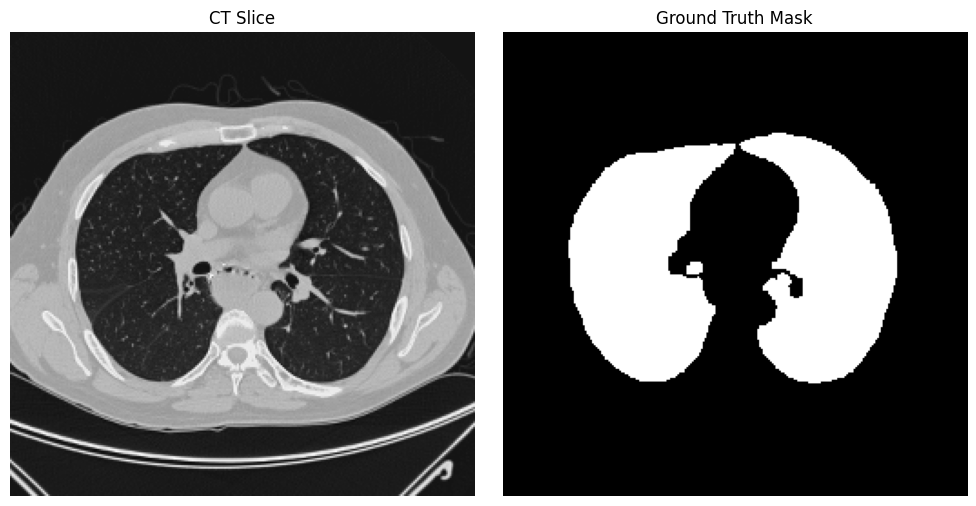

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.272042302501586336192628818865: 280

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.277445975068759205899107114231
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.277445975068759205899107114231...


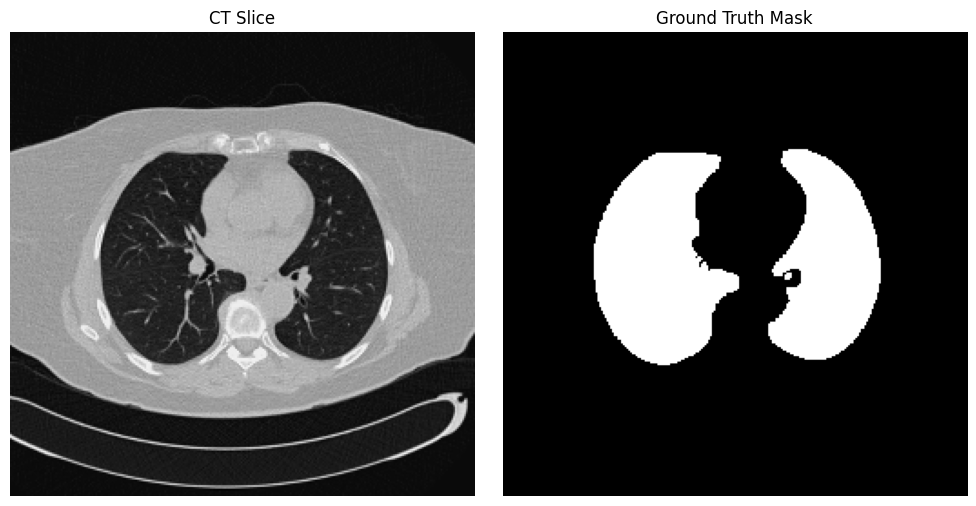

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.277445975068759205899107114231: 319

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.278660284797073139172446973682
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.278660284797073139172446973682...


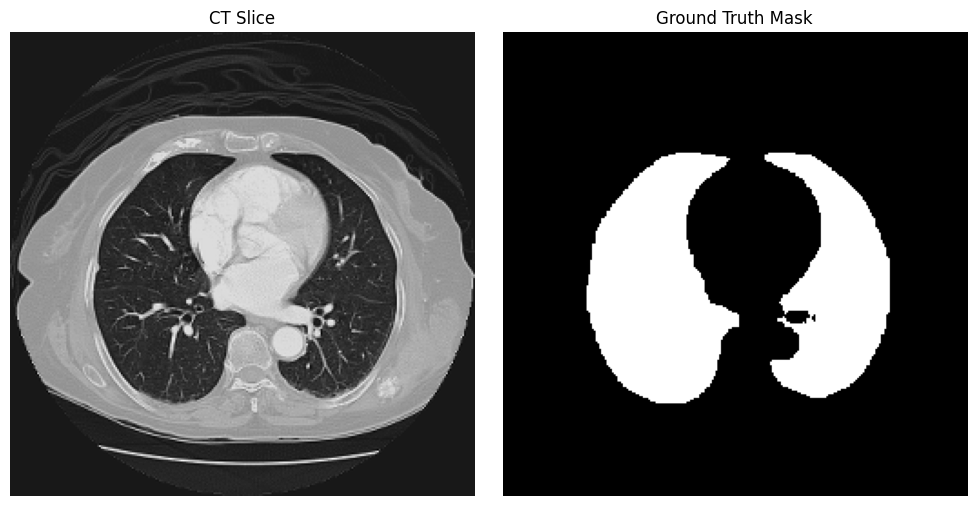

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.278660284797073139172446973682: 292

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.280972147860943609388015648430
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.280972147860943609388015648430...


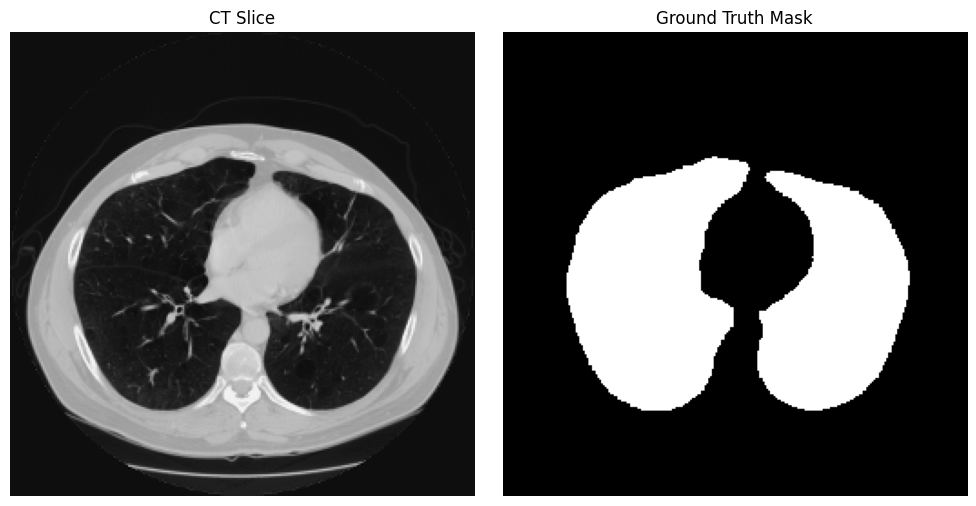

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.280972147860943609388015648430: 348

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.281489753704424911132261151767
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.281489753704424911132261151767...


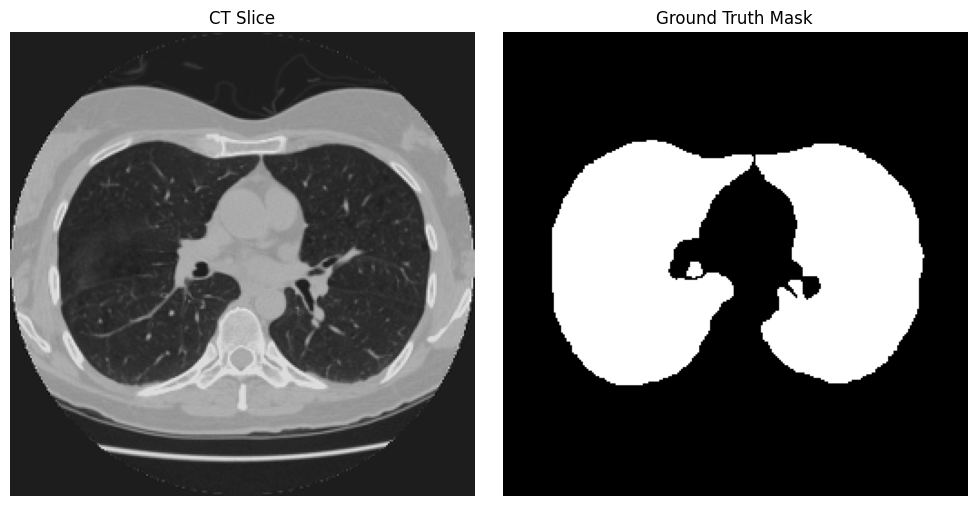

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.281489753704424911132261151767: 294

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.293757615532132808762625441831
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.293757615532132808762625441831...


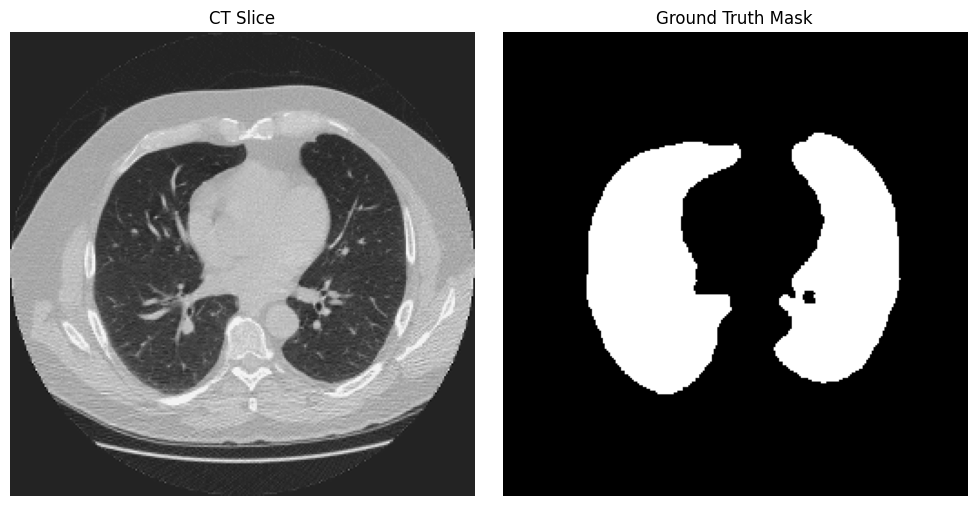

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.293757615532132808762625441831: 298

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111...


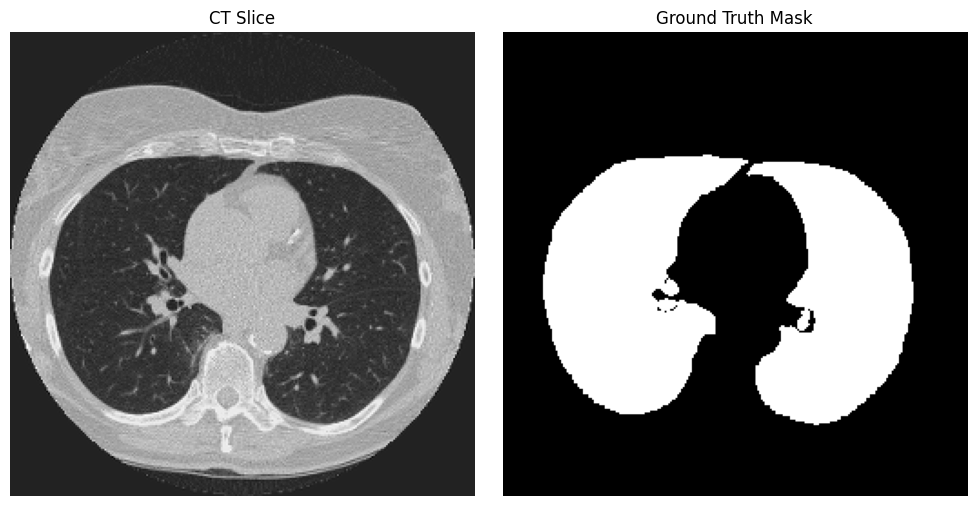

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111: 312

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.295298571102631191572192562523
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.295298571102631191572192562523...


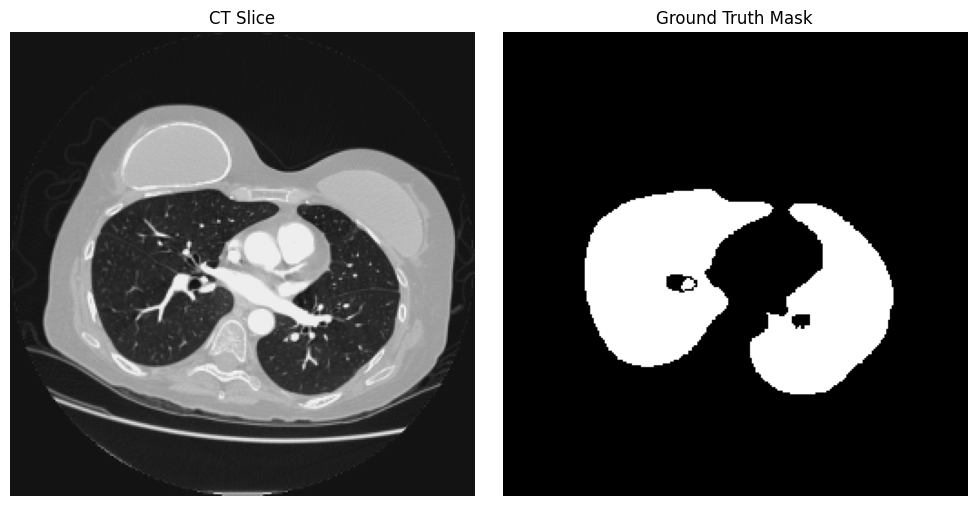

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.295298571102631191572192562523: 290

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.295420274214095686326263147663
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.295420274214095686326263147663...


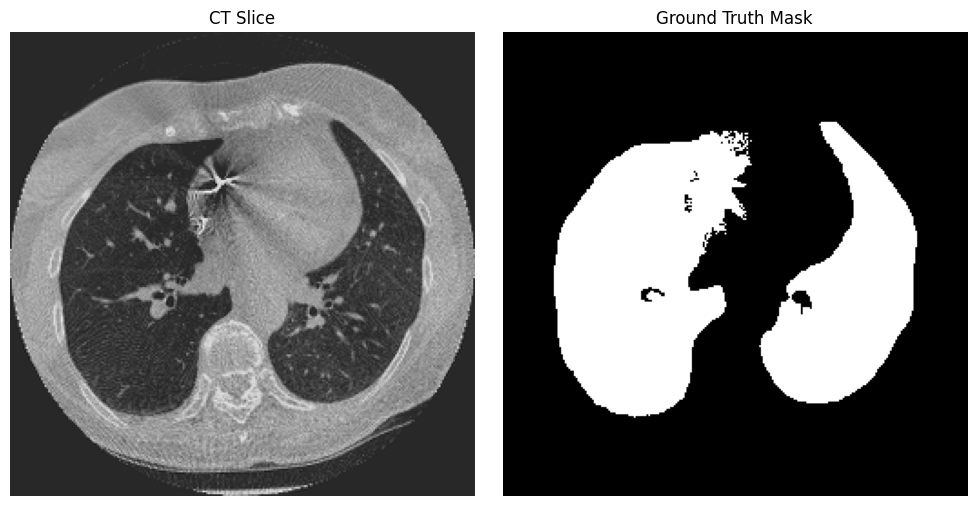

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.295420274214095686326263147663: 305

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.302134342469412607966016057827
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.302134342469412607966016057827...


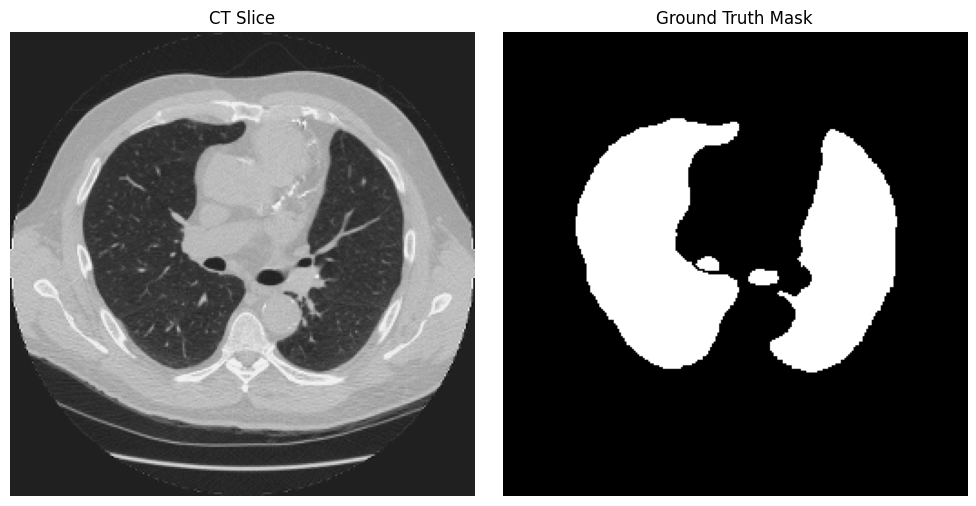

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.302134342469412607966016057827: 231

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.303421828981831854739626597495
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.303421828981831854739626597495...


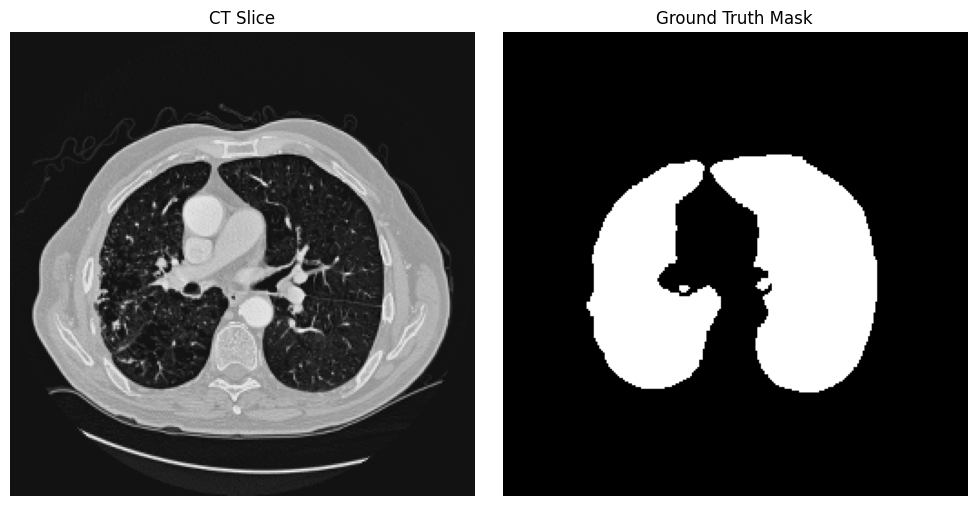

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.303421828981831854739626597495: 300

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.305858704835252413616501469037
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.305858704835252413616501469037...


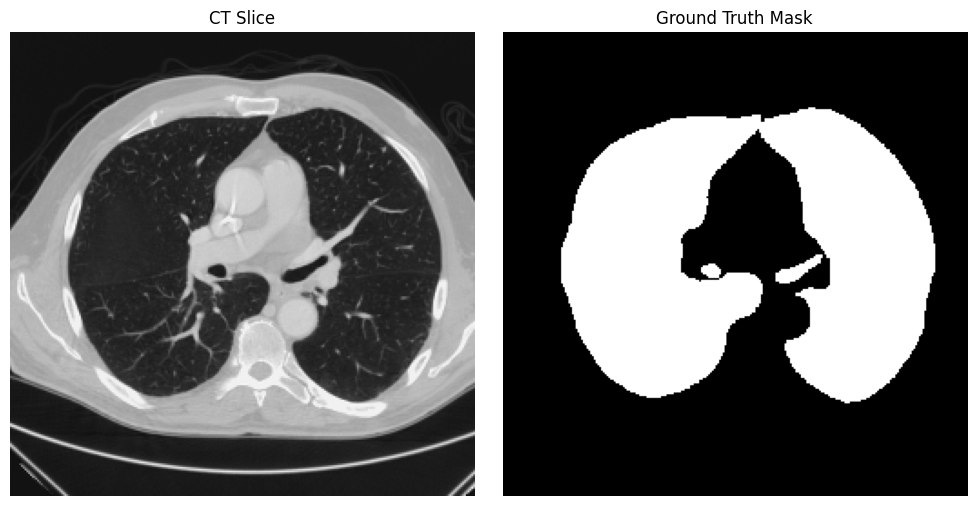

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.305858704835252413616501469037: 290

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.310548927038333190233889983845
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.310548927038333190233889983845...


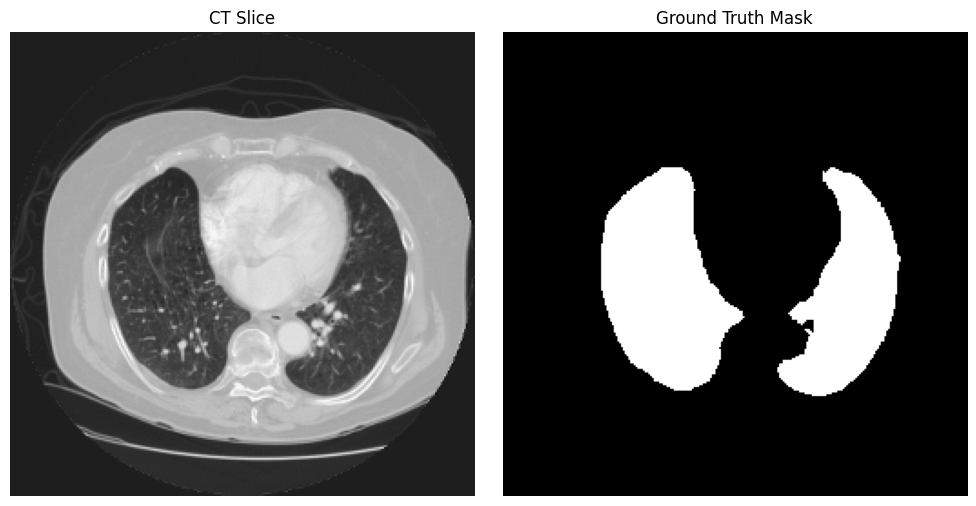

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.310548927038333190233889983845: 318

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.310626494937915759224334597176
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.310626494937915759224334597176...


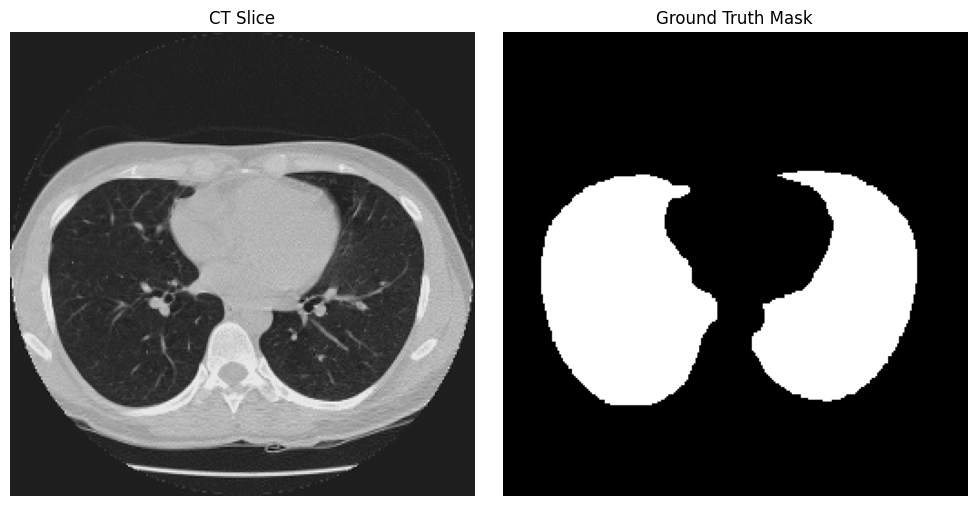

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.310626494937915759224334597176: 318

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.311981398931043315779172047718
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.311981398931043315779172047718...


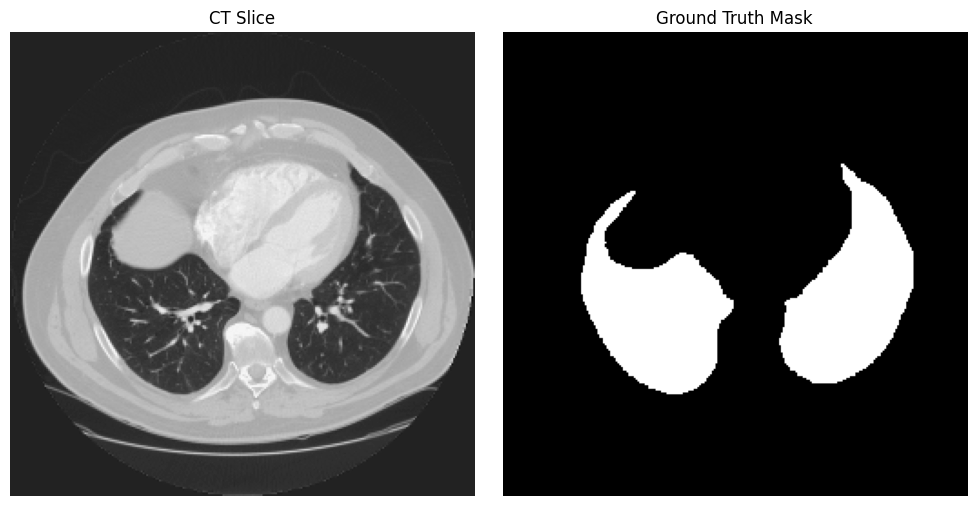

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.311981398931043315779172047718: 378

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.313334055029671473836954456733
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.313334055029671473836954456733...


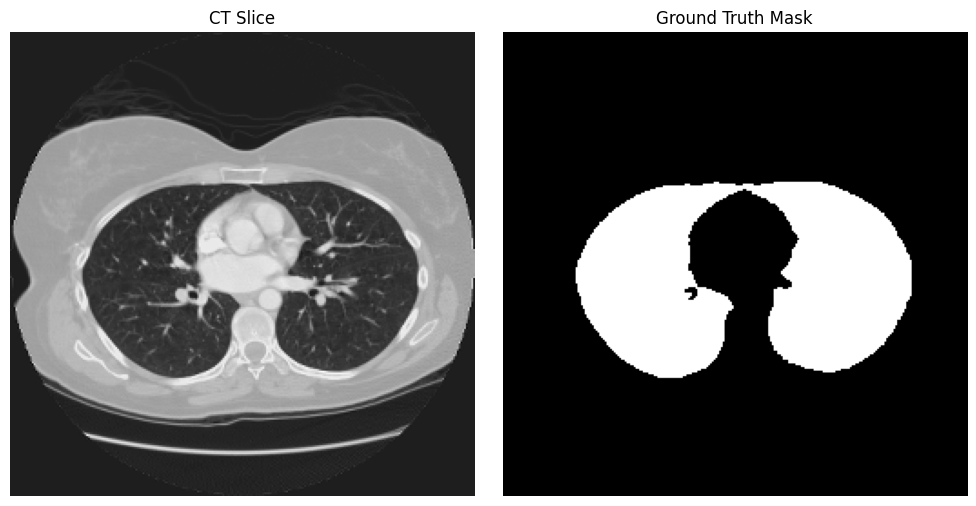

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.313334055029671473836954456733: 308

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.313605260055394498989743099991
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.313605260055394498989743099991...


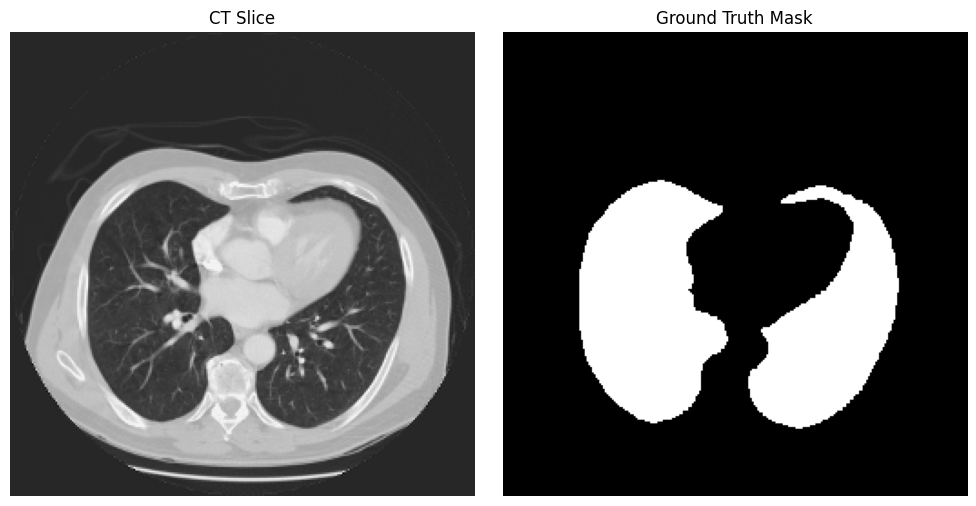

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.313605260055394498989743099991: 322

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.313835996725364342034830119490
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.313835996725364342034830119490...


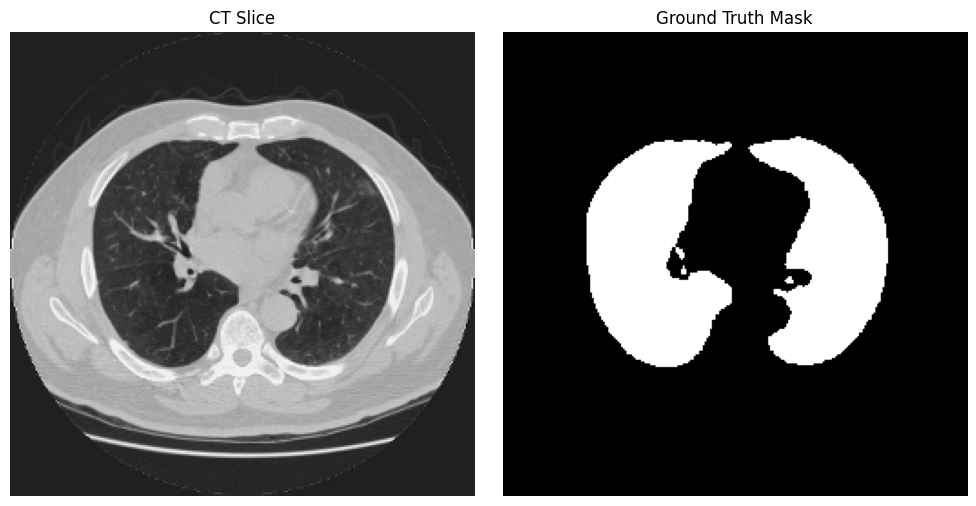

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.313835996725364342034830119490: 291

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.317087518531899043292346860596
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.317087518531899043292346860596...


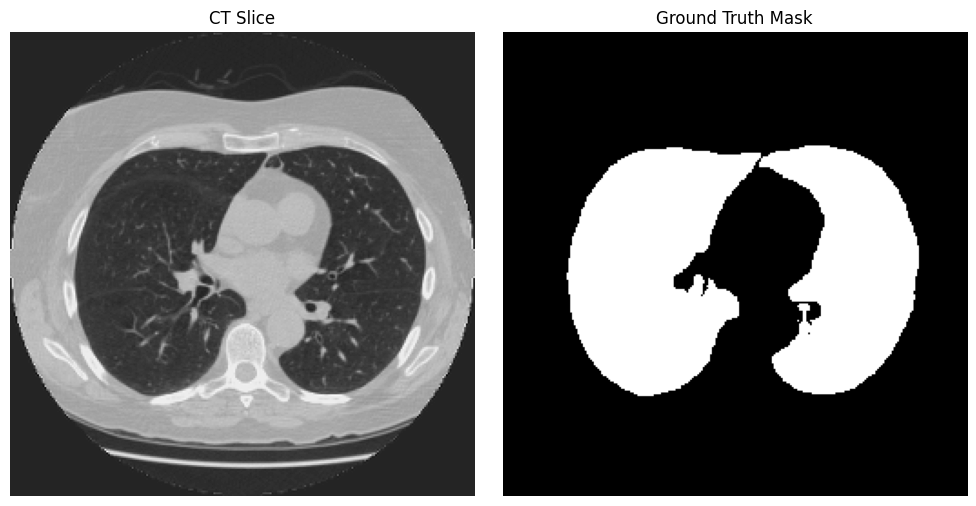

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.317087518531899043292346860596: 296

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.323302986710576400812869264321
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.323302986710576400812869264321...


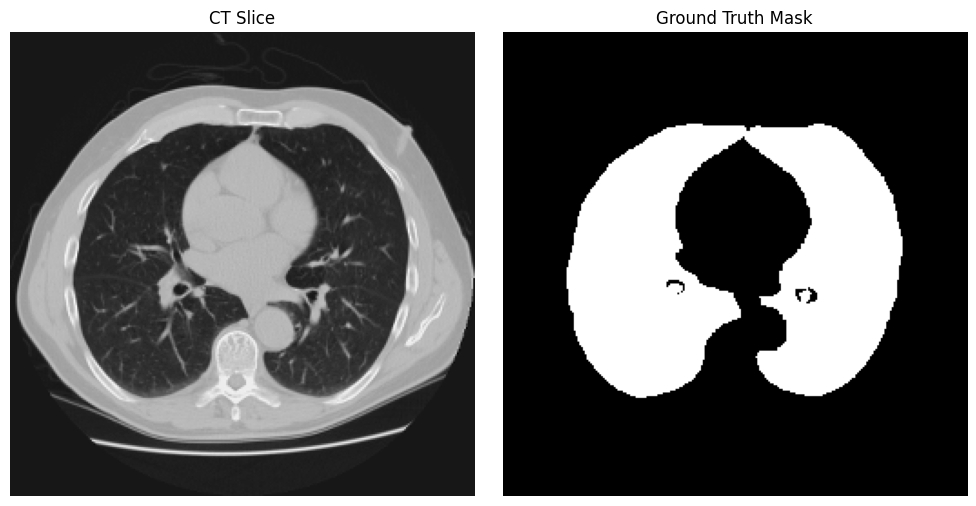

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.323302986710576400812869264321: 314

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.323859712968543712594665815359
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.323859712968543712594665815359...


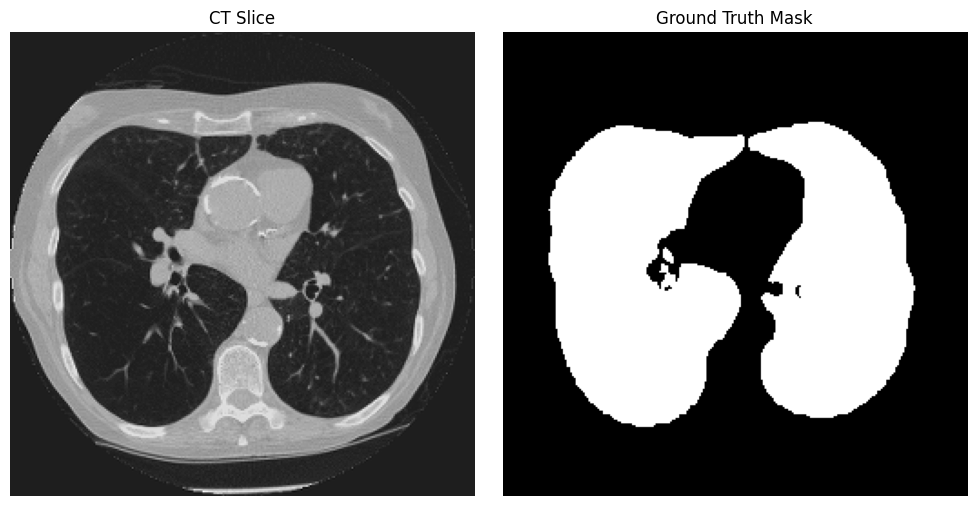

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.323859712968543712594665815359: 334

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.332453873575389860371315979768
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.332453873575389860371315979768...


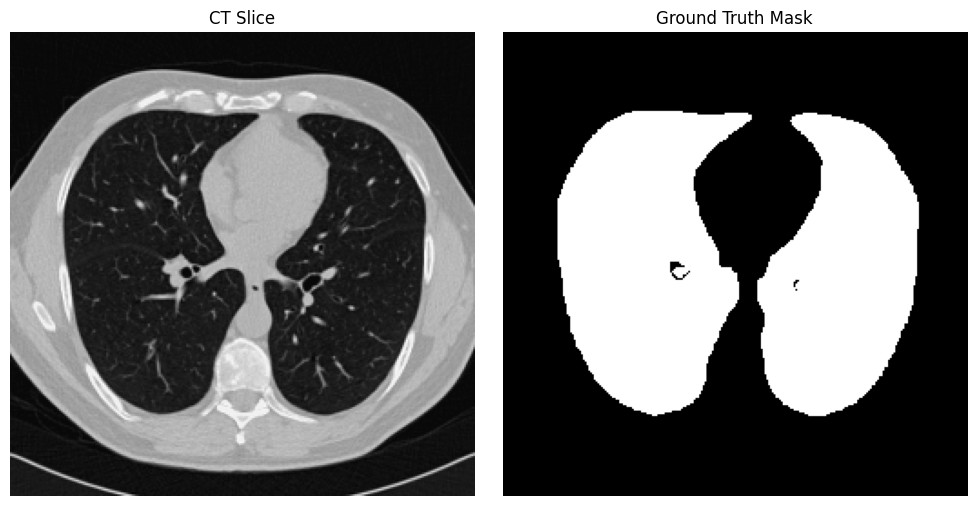

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.332453873575389860371315979768: 367

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.333145094436144085379032922488
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.333145094436144085379032922488...


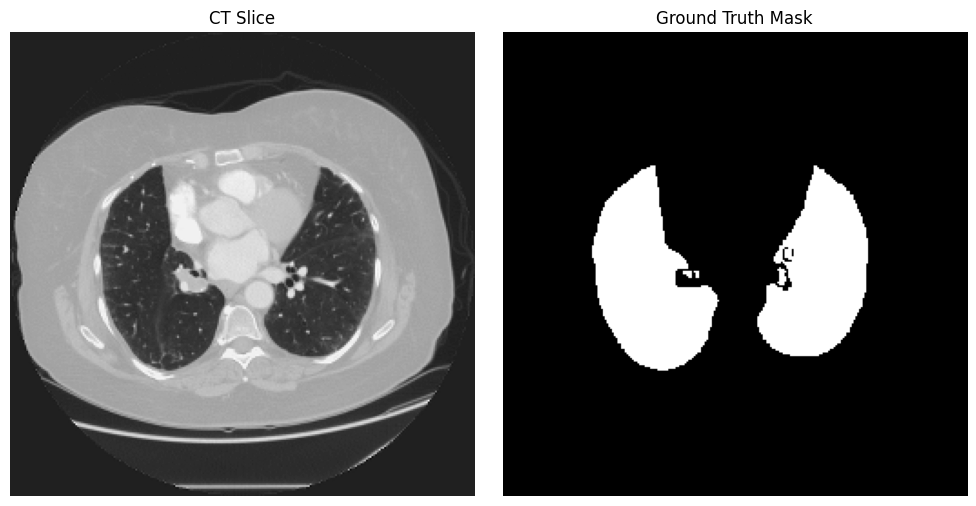

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.333145094436144085379032922488: 348

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.334517907433161353885866806005
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.334517907433161353885866806005...


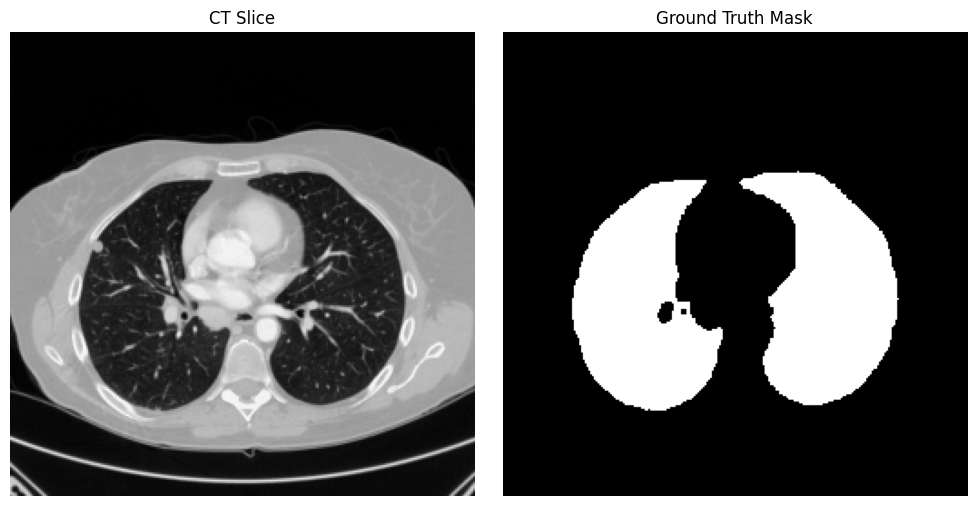

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.334517907433161353885866806005: 280

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.395623571499047043765181005112
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.395623571499047043765181005112...


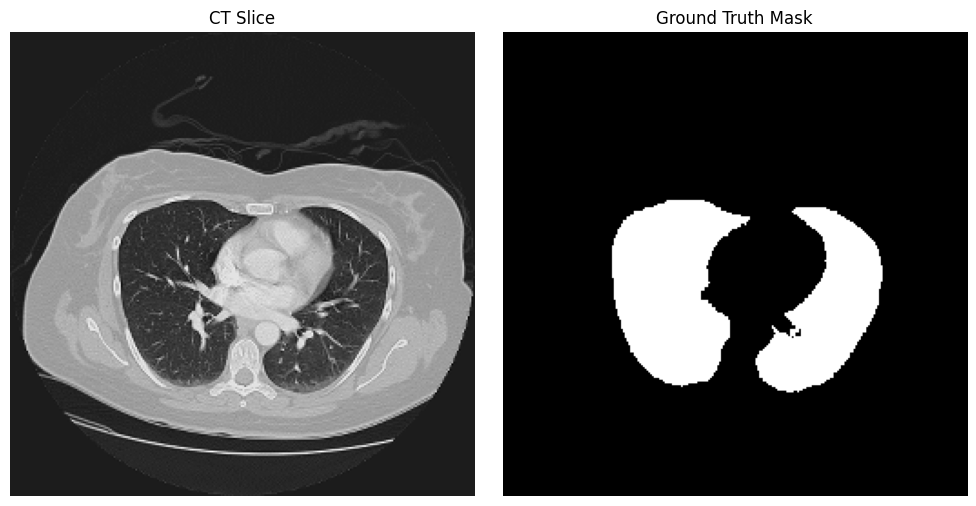

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.395623571499047043765181005112: 272

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.397062004302272014259317520874
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.397062004302272014259317520874...


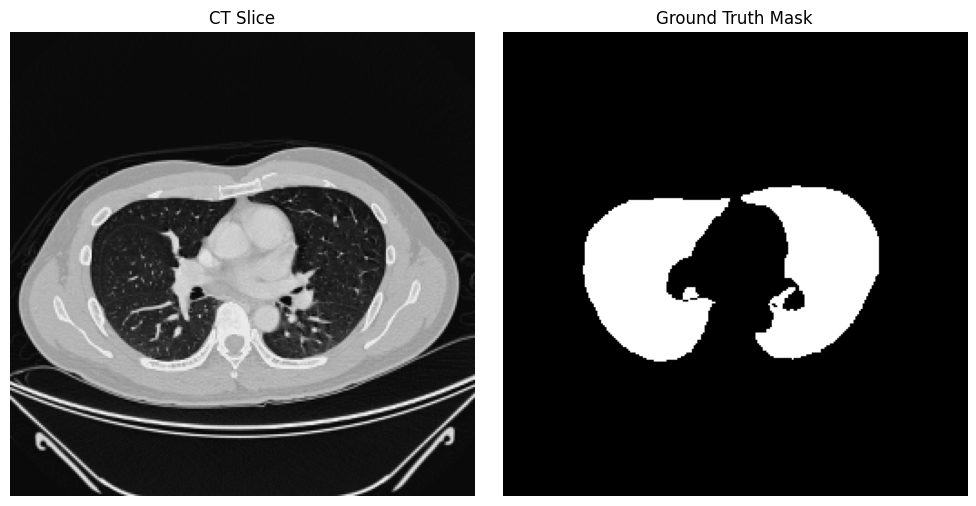

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.397062004302272014259317520874: 325

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.404364125369979066736354549484
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.404364125369979066736354549484...


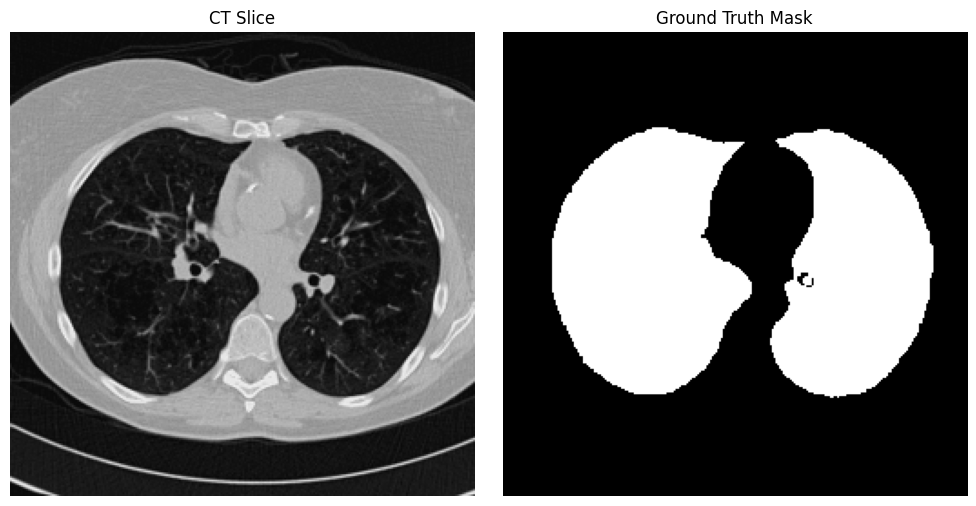

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.404364125369979066736354549484: 317

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.417815314896088956784723476543
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.417815314896088956784723476543...


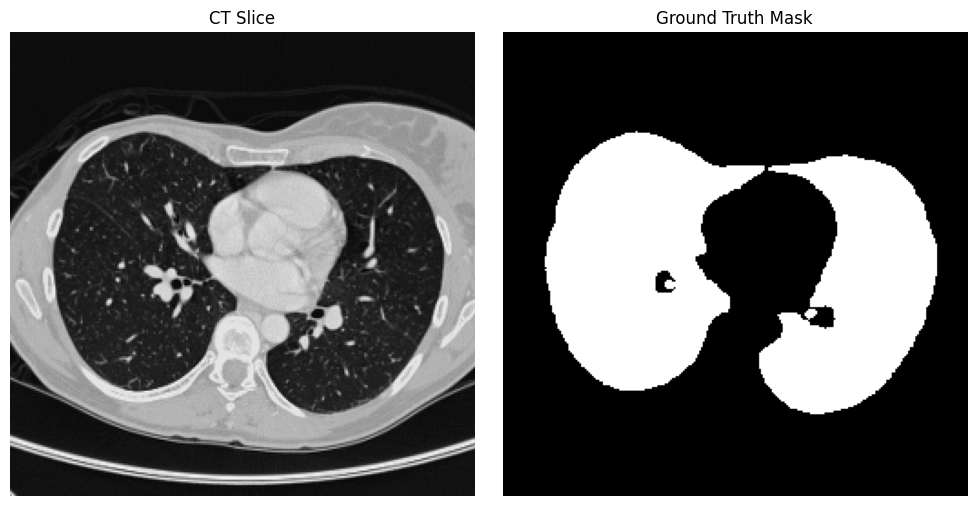

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.417815314896088956784723476543: 280

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.430109407146633213496148200410
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.430109407146633213496148200410...


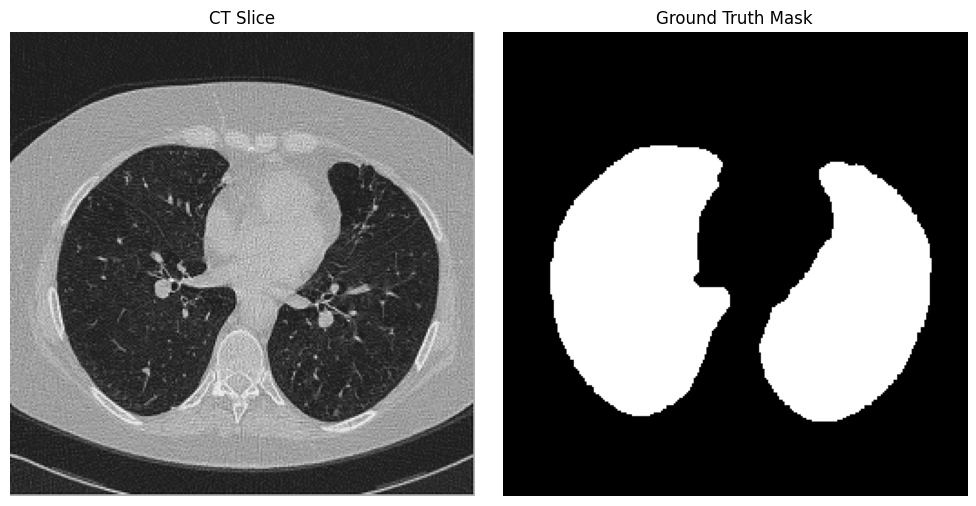

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.430109407146633213496148200410: 366

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.450501966058662668272378865145
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.450501966058662668272378865145...


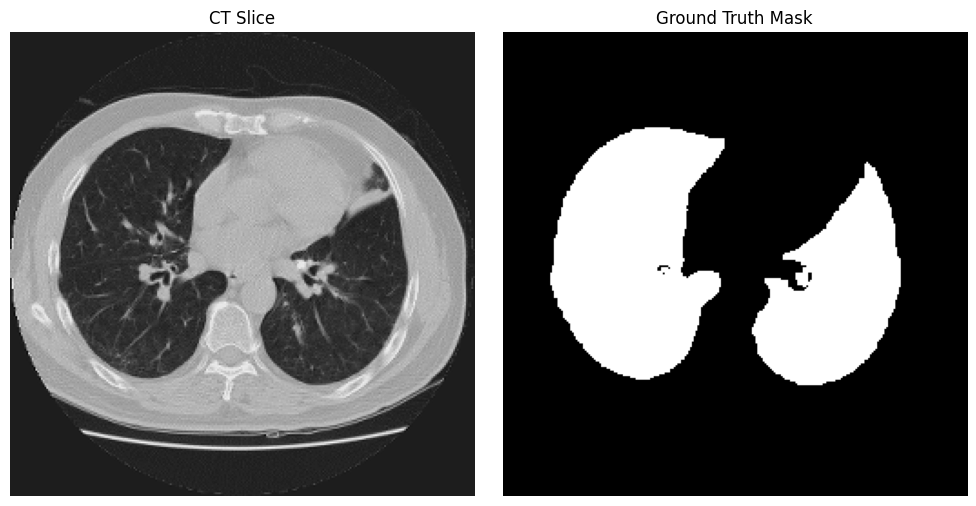

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.450501966058662668272378865145: 322

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.511347030803753100045216493273
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.511347030803753100045216493273...


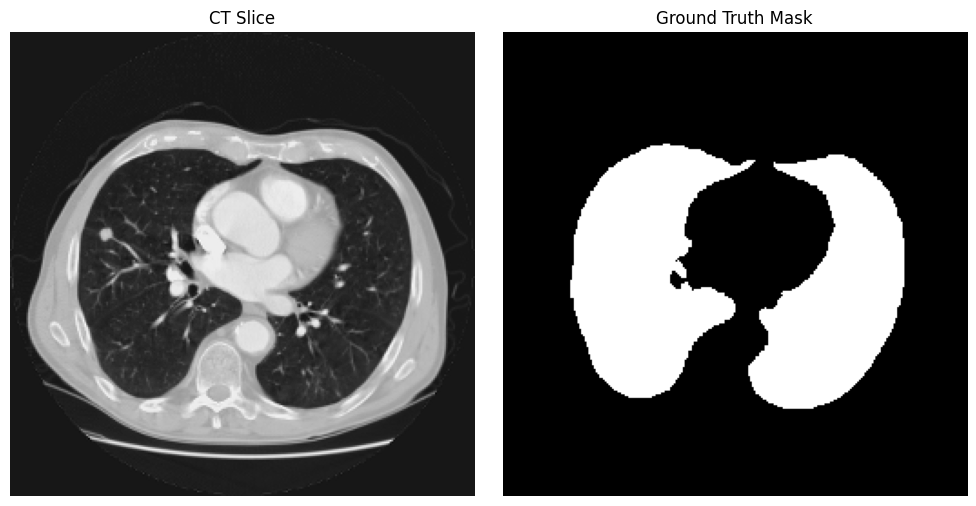

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.511347030803753100045216493273: 368

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.525937963993475482158828421281
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.525937963993475482158828421281...


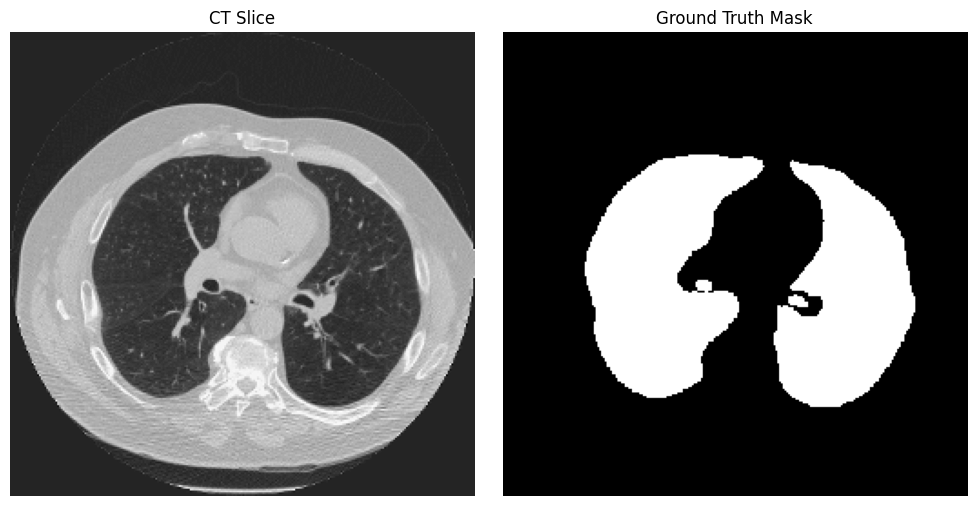

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.525937963993475482158828421281: 322

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.534006575256943390479252771547
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.534006575256943390479252771547...


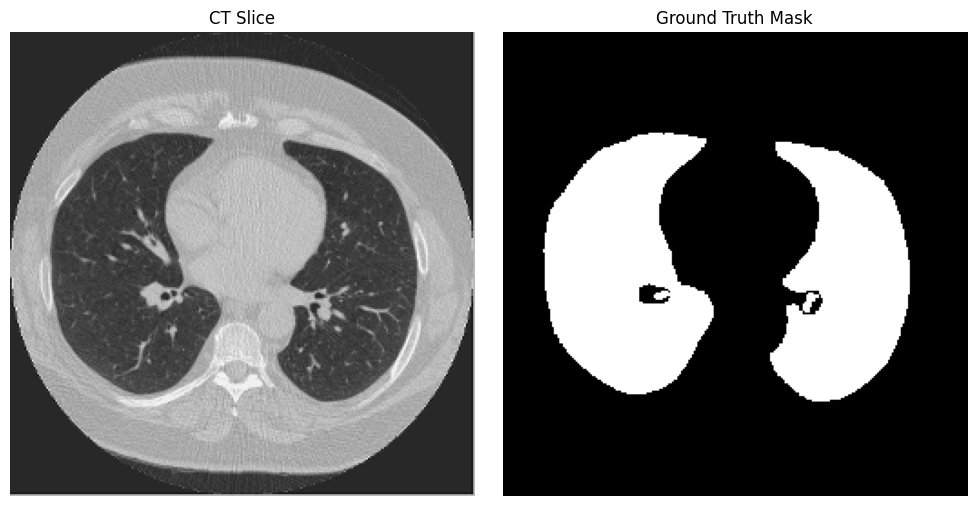

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.534006575256943390479252771547: 341

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.534083630500464995109143618896
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.534083630500464995109143618896...


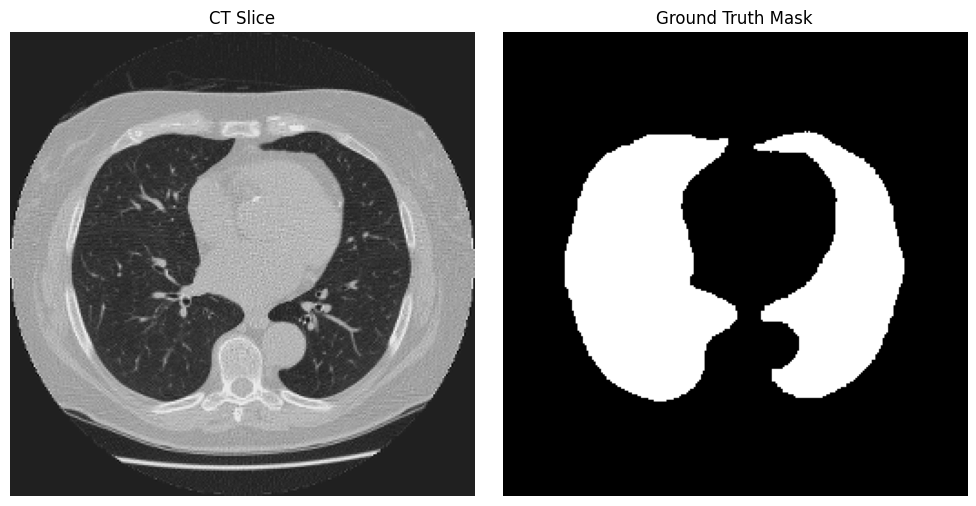

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.534083630500464995109143618896: 286

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.564534197011295112247542153557
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.564534197011295112247542153557...


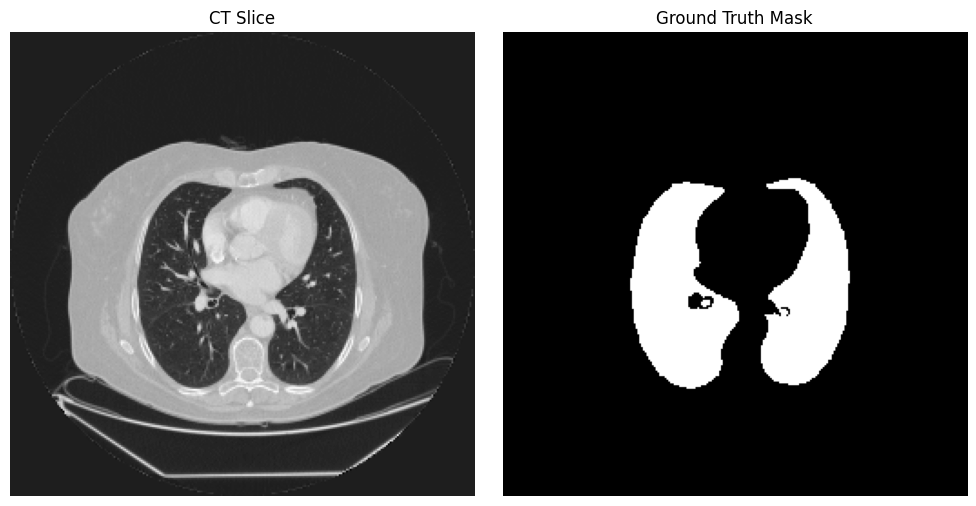

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.564534197011295112247542153557: 331

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.566816709786169715745131047975
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.566816709786169715745131047975...


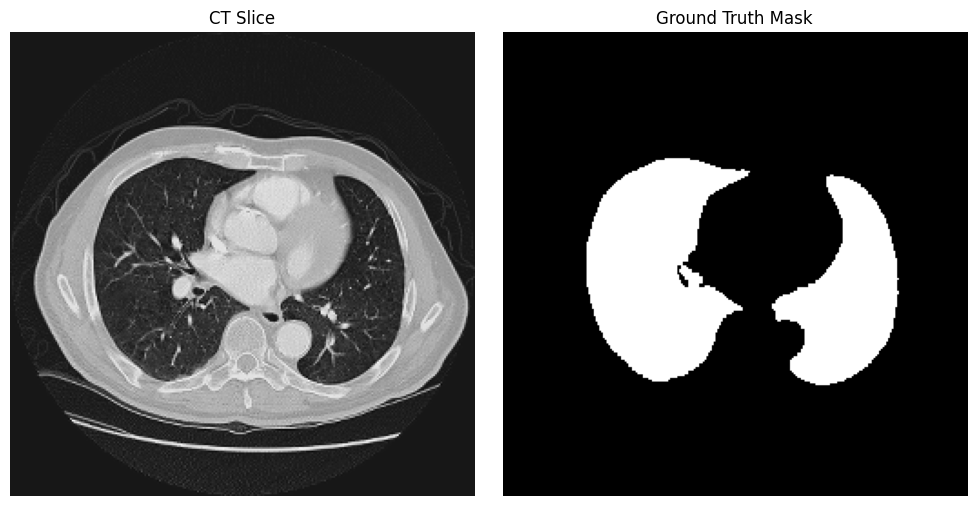

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.566816709786169715745131047975: 332

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.621916089407825046337959219998
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.621916089407825046337959219998...


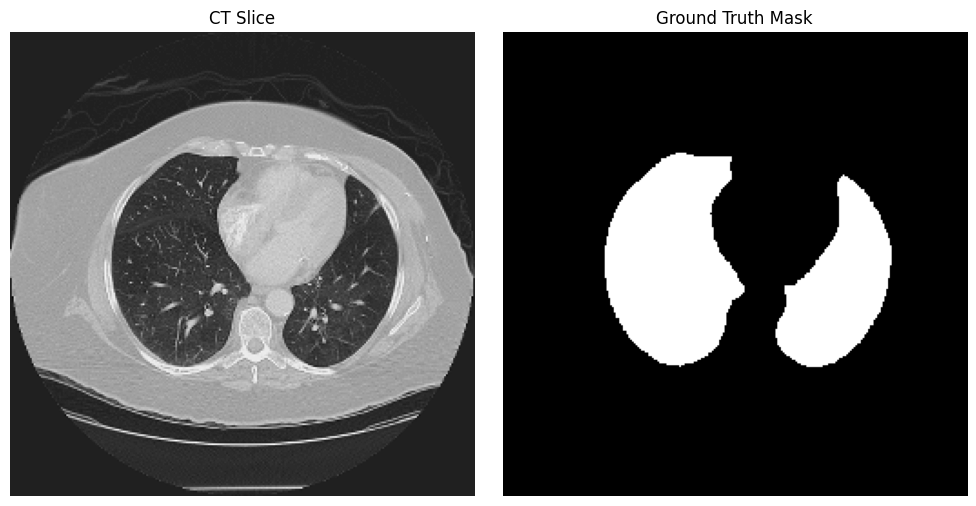

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.621916089407825046337959219998: 332

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.640729228179368154416184318668
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.640729228179368154416184318668...


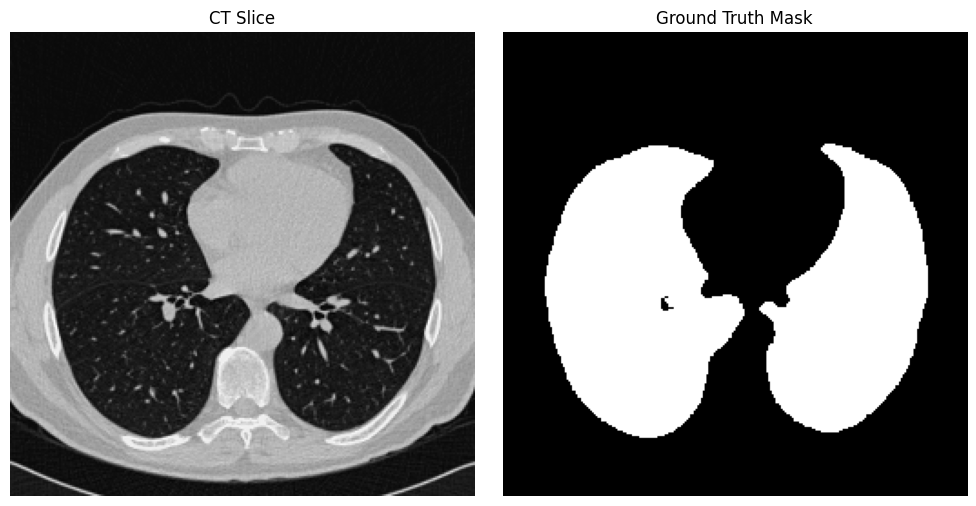

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.640729228179368154416184318668: 338

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.657775098760536289051744981056
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.657775098760536289051744981056...


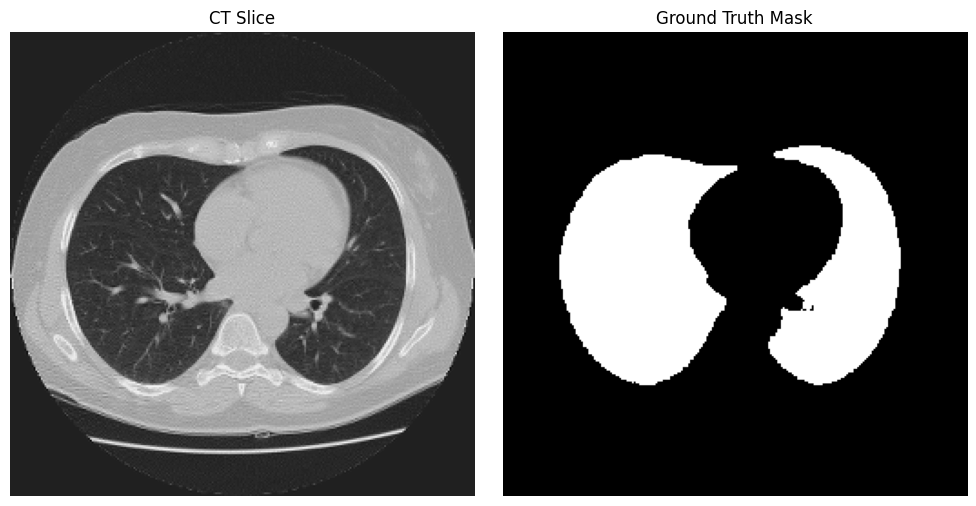

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.657775098760536289051744981056: 300

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.716498695101447665580610403574
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.716498695101447665580610403574...


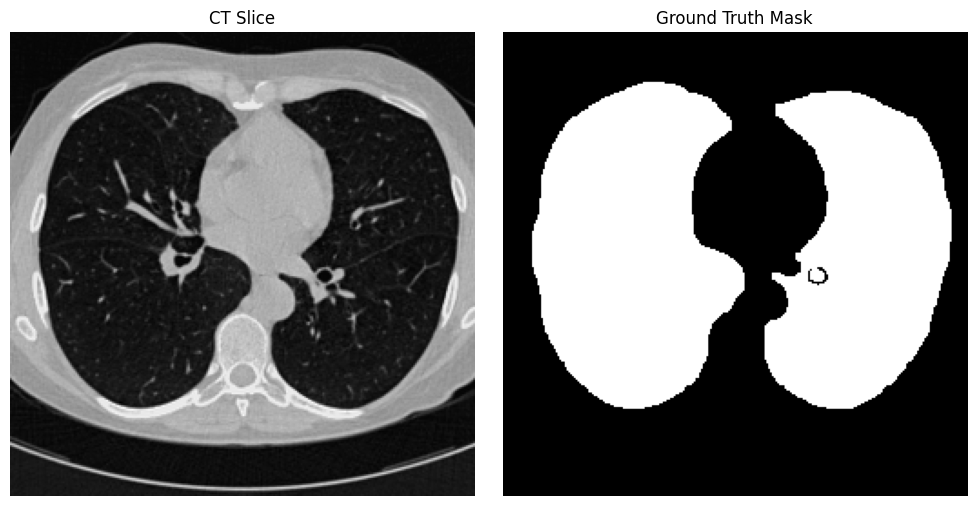

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.716498695101447665580610403574: 300

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.724251104254976962355686318345
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.724251104254976962355686318345...


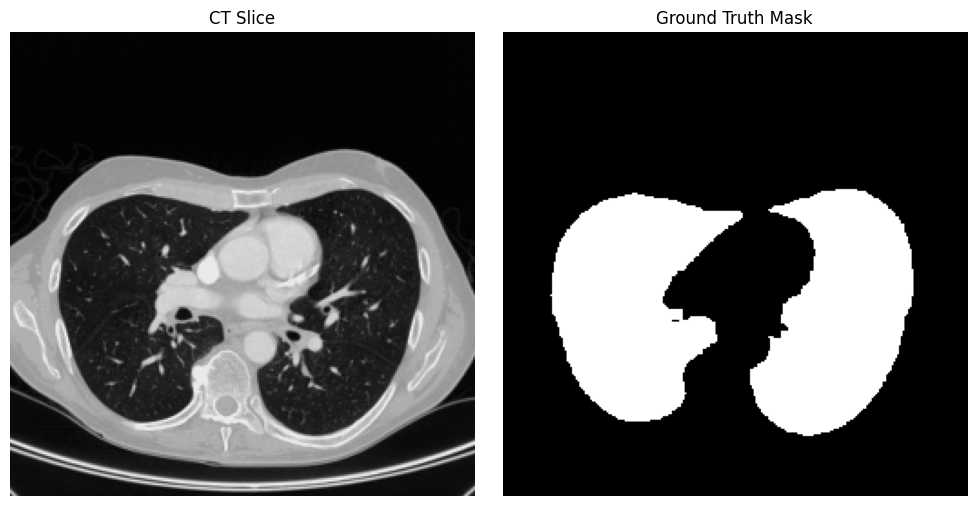

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.724251104254976962355686318345: 294

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.752756872840730509471096155114
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.752756872840730509471096155114...


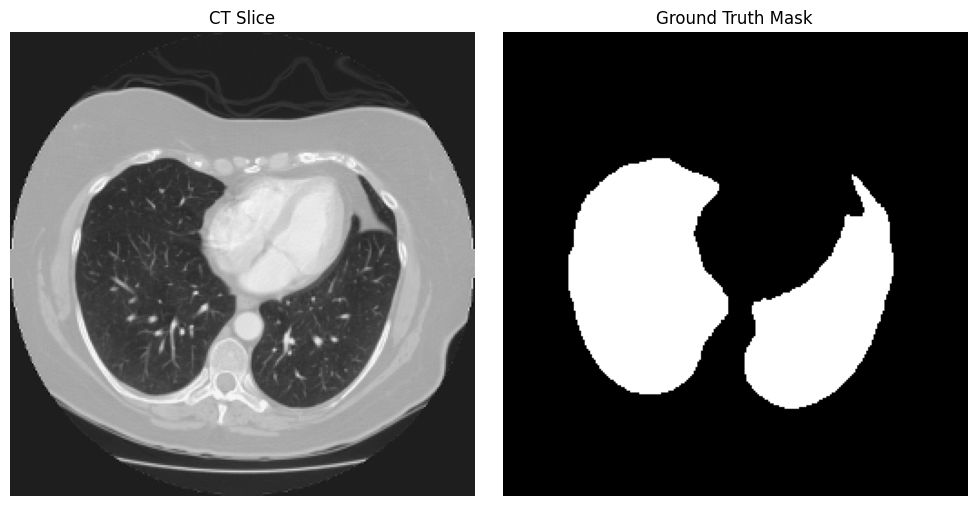

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.752756872840730509471096155114: 318

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.805925269324902055566754756843
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.805925269324902055566754756843...


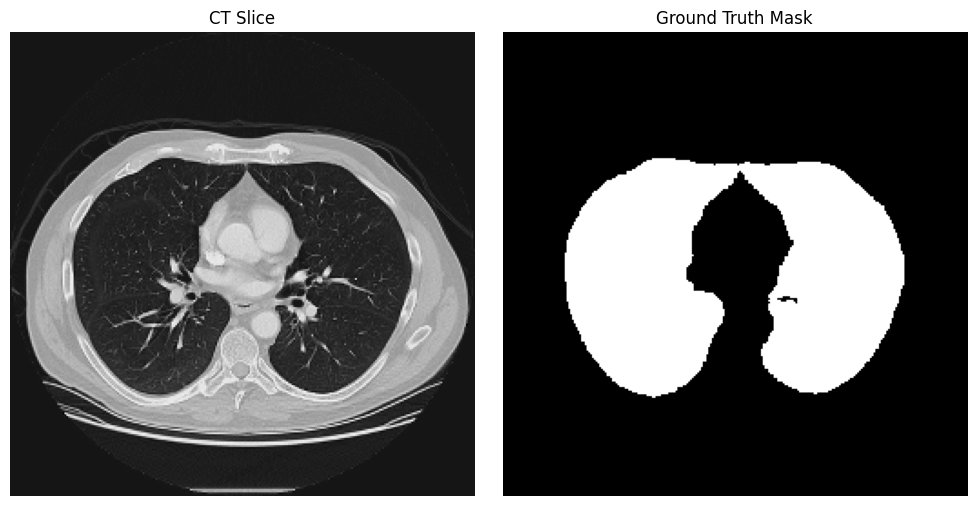

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.805925269324902055566754756843: 352

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.826812708000318290301835871780
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413924881662621747734...


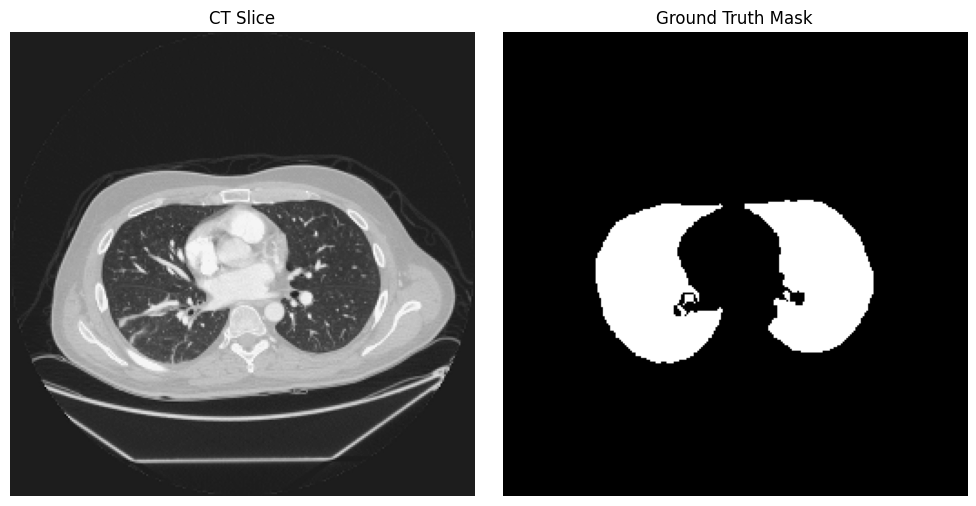

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413924881662621747734: 308

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028521482602829374444
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028521482602829374444...


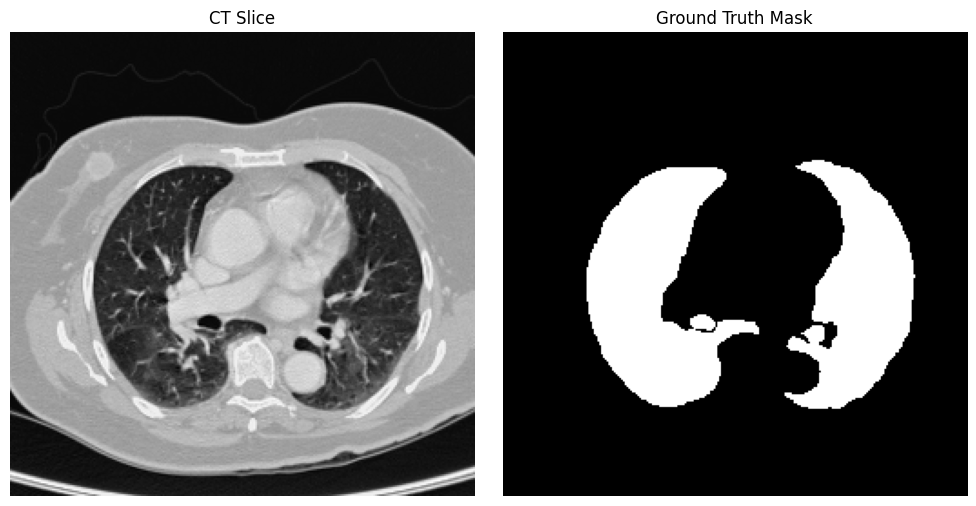

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028521482602829374444: 200

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588660410240398317235
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588660410240398317235...


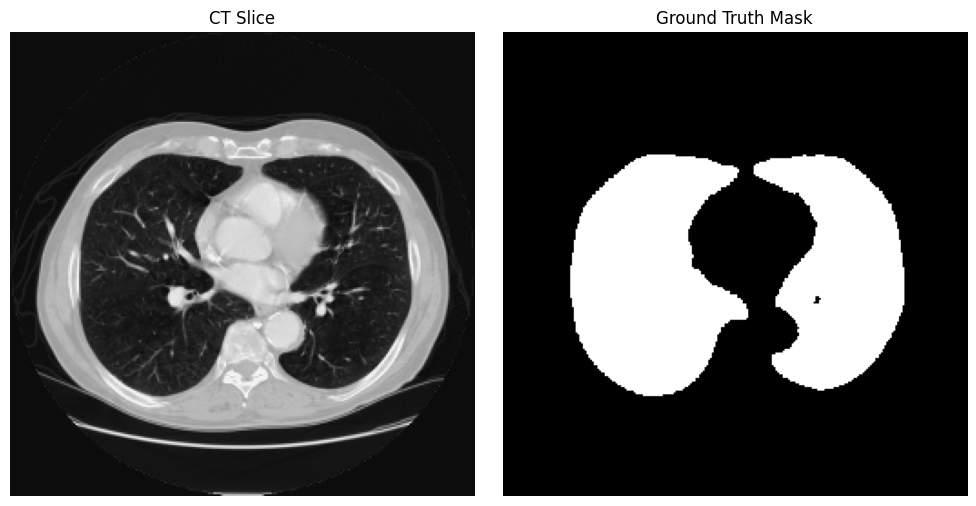

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588660410240398317235: 380

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.975254950136384517744116790879
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.975254950136384517744116790879...


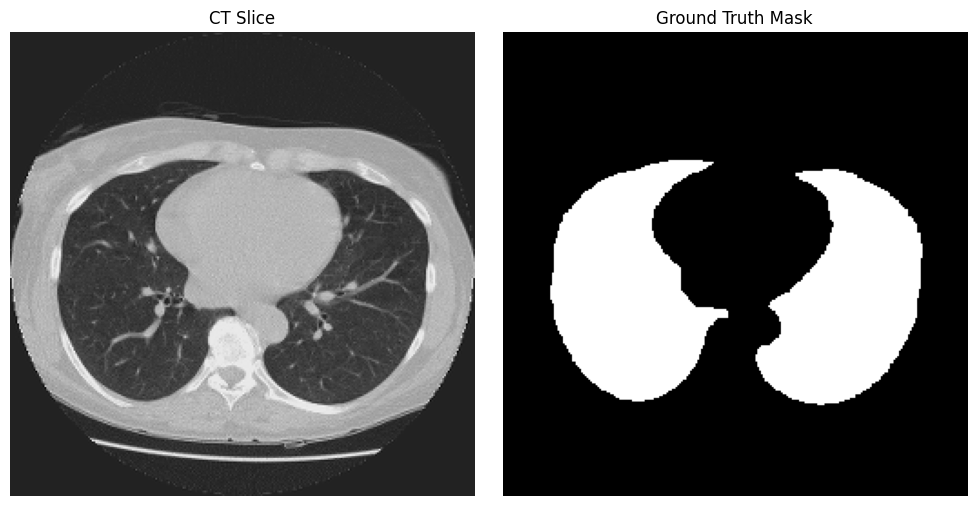

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.975254950136384517744116790879: 310

Processing scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.979083010707182900091062408058
Visualizing a sample slice from scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.979083010707182900091062408058...


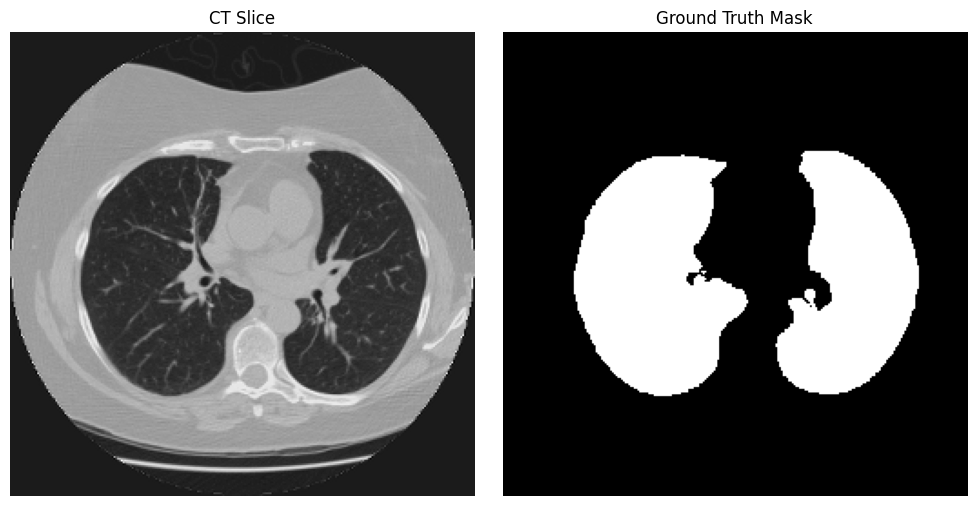

Total slices extracted for scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.979083010707182900091062408058: 280

Preprocessing complete! Total number of slices extracted: 27723


In [5]:
# Step 1: Preprocess the data
print("\nStep 1: Preprocessing data...")
all_slices = preprocess_luna16_subset0(SUBSET0_CT_DIR, SUBSET0_GT_DIR, PREPROCESSED_DIR, max_scans=None)

# Clear memory after preprocessing
import gc
gc.collect()
torch.cuda.empty_cache()

### Split into Train and Validation Sets

In [6]:
# Step 2: Split into train and validation sets
print("\nStep 2: Splitting data into train and validation sets...")
np.random.seed(42)
np.random.shuffle(all_slices)
train_size = int(0.8 * len(all_slices))
train_slices = all_slices[:train_size]
val_slices = all_slices[train_size:]
print(f"Training slices: {len(train_slices)}")
print(f"Validation slices: {len(val_slices)}")
print(f"Total slices (check): {len(train_slices) + len(val_slices)} (should match {len(all_slices)})")


Step 2: Splitting data into train and validation sets...
Training slices: 22178
Validation slices: 5545
Total slices (check): 27723 (should match 27723)


In [7]:
# Step 2.5: Check for data leakage
print("\nStep 2.5: Checking for data leakage...")
train_slice_ids = {slice_id for slice_id, _, _ in train_slices}
val_slice_ids = {slice_id for slice_id, _, _ in val_slices}
common_slice_ids = train_slice_ids.intersection(val_slice_ids)
if common_slice_ids:
    raise ValueError(f"Data leakage detected! Found {len(common_slice_ids)} overlapping slice IDs: {list(common_slice_ids)[:5]}...")
else:
    print("No data leakage detected. Train and validation sets are disjoint.")


Step 2.5: Checking for data leakage...
No data leakage detected. Train and validation sets are disjoint.


### Define Dataset Class
 

In [8]:
# Dataset Class for U-Net Training
class LUNA16SliceDataset(Dataset):
    """PyTorch Dataset for loading preprocessed LUNA16 slices"""
    def __init__(self, slice_list, preprocessed_dir):
        self.slice_list = slice_list
        self.preprocessed_dir = preprocessed_dir

    def __len__(self):
        return len(self.slice_list)

    def __getitem__(self, idx):
        slice_id, _, _ = self.slice_list[idx]
        ct_path = os.path.join(self.preprocessed_dir, "ct_slices", f"{slice_id}.npz")
        gt_path = os.path.join(self.preprocessed_dir, "gt_slices", f"{slice_id}.npz")

        ct_npz = np.load(ct_path, mmap_mode='r')
        gt_npz = np.load(gt_path, mmap_mode='r')
        ct_slice = ct_npz['data']
        gt_slice = gt_npz['data']

        ct_tensor = torch.FloatTensor(ct_slice).unsqueeze(0)
        gt_tensor = torch.FloatTensor(gt_slice).unsqueeze(0)

        return ct_tensor, gt_tensor

### Create Datasets and Dataloaders

In [9]:
# Step 3: Create datasets and dataloaders
print("\nStep 3: Creating datasets and dataloaders...")
train_dataset = LUNA16SliceDataset(train_slices, PREPROCESSED_DIR)
val_dataset = LUNA16SliceDataset(val_slices, PREPROCESSED_DIR)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
print(f"Number of training batches: {len(train_loader)}")
print(f"Number of validation batches: {len(val_loader)}")


Step 3: Creating datasets and dataloaders...
Number of training batches: 11089
Number of validation batches: 2773


In [10]:
# Step 3: Create datasets and dataloaders
print("\nStep 3: Creating datasets and dataloaders...")
train_dataset = LUNA16SliceDataset(train_slices, PREPROCESSED_DIR)
val_dataset = LUNA16SliceDataset(val_slices, PREPROCESSED_DIR)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
print(f"Number of training batches: {len(train_loader)}")
print(f"Number of validation batches: {len(val_loader)}")


Step 3: Creating datasets and dataloaders...
Number of training batches: 11089
Number of validation batches: 2773


### Define U-Net Model

In [11]:
# U-Net Model
class UNet(nn.Module):
    def __init__(self, in_channels=1, out_channels=1):
        super(UNet, self).__init__()

        def conv_block(in_ch, out_ch):
            return nn.Sequential(
                nn.Conv2d(in_ch, out_ch, 3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_ch, out_ch, 3, padding=1),
                nn.ReLU(inplace=True)
            )

        self.enc1 = conv_block(in_channels, 64)
        self.enc2 = conv_block(64, 128)
        self.enc3 = conv_block(128, 256)
        self.enc4 = conv_block(256, 512)

        self.pool = nn.MaxPool2d(2, 2)
        self.upconv3 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.dec3 = conv_block(512, 256)
        self.upconv2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.dec2 = conv_block(256, 128)
        self.upconv1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.dec1 = conv_block(128, 64)
        self.final = nn.Conv2d(64, out_channels, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool(e1))
        e3 = self.enc3(self.pool(e2))
        e4 = self.enc4(self.pool(e3))

        d3 = self.upconv3(e4)
        d3 = torch.cat([d3, e3], dim=1)
        d3 = self.dec3(d3)
        d2 = self.upconv2(d3)
        d2 = torch.cat([d2, e2], dim=1)
        d2 = self.dec2(d2)
        d1 = self.upconv1(d2)
        d1 = torch.cat([d1, e1], dim=1)
        d1 = self.dec1(d1)
        out = self.final(d1)
        out = self.sigmoid(out)
        return out

### Define Dice Loss

This step defines the Dice loss function for training the U-Net.

In [12]:
# Dice Loss
class DiceLoss(nn.Module):
    def __init__(self):
        super(DiceLoss, self).__init__()

    def forward(self, pred, target):
        smooth = 1e-5
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        return 1 - ((2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth))

### Training Function
This step defines the training function for the U-Net.

In [13]:
# Training Function
def train_unet(model, train_loader, val_loader, num_epochs=NUM_EPOCHS, device=DEVICE):
    model = model.to(device)
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    criterion = DiceLoss()
    accum_steps = 4  # Simulate batch size of 8 (2 * 4)

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        for batch_idx, (ct, gt) in enumerate(train_loader):
            ct, gt = ct.to(device), gt.to(device)
            pred = model(ct)
            loss = criterion(pred, gt)
            loss = loss / accum_steps
            loss.backward()

            if (batch_idx + 1) % accum_steps == 0:
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                optimizer.step()
                optimizer.zero_grad()

            train_loss += loss.item() * accum_steps
        train_loss /= len(train_loader)

        model.eval()
        val_loss = 0
        val_iou = 0
        with torch.no_grad():
            for ct, gt in val_loader:
                ct, gt = ct.to(device), gt.to(device)
                pred = model(ct)
                loss = criterion(pred, gt)
                val_loss += loss.item()
                pred_binary = (pred > 0.5).float()
                iou = jaccard_score(gt.cpu().numpy().flatten(), pred_binary.cpu().numpy().flatten())
                val_iou += iou
        val_loss /= len(val_loader)
        val_iou /= len(val_loader)

        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, Val IoU: {val_iou:.4f}")

    return model

### Train the U-Net
This step initializes and trains the U-Net model.

In [14]:
# Step 4: Train the U-Net
if torch.cuda.is_available():
    print(f"GPU Memory Allocated: {torch.cuda.memory_allocated() / 1024**3:.2f} GB")
    print(f"GPU Memory Cached: {torch.cuda.memory_reserved() / 1024**3:.2f} GB")

print("\nStep 4: Training U-Net...")
model = UNet(in_channels=1, out_channels=1)
model = train_unet(model, train_loader, val_loader, num_epochs=NUM_EPOCHS, device=DEVICE)

GPU Memory Allocated: 0.00 GB
GPU Memory Cached: 0.00 GB

Step 4: Training U-Net...


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/10, Train Loss: 0.0926, Val Loss: 0.0608, Val IoU: 0.9121


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 2/10, Train Loss: 0.0519, Val Loss: 0.0490, Val IoU: 0.9253


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 3/10, Train Loss: 0.0452, Val Loss: 0.0468, Val IoU: 0.9287


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 4/10, Train Loss: 0.0422, Val Loss: 0.0406, Val IoU: 0.9295


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 5/10, Train Loss: 0.0383, Val Loss: 0.0404, Val IoU: 0.9339


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 6/10, Train Loss: 0.0346, Val Loss: 0.0400, Val IoU: 0.9380


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 7/10, Train Loss: 0.0336, Val Loss: 0.0419, Val IoU: 0.9344


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 8/10, Train Loss: 0.0323, Val Loss: 0.0348, Val IoU: 0.9396


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 9/10, Train Loss: 0.0343, Val Loss: 0.0338, Val IoU: 0.9394


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 due to no true or predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Jacc

Epoch 10/10, Train Loss: 0.0321, Val Loss: 0.0384, Val IoU: 0.9385


### Prediction and Saving Masks
This step uses the trained U-Net to predict lung masks for all scans in subset0 and saves them for the detection model.

In [15]:
# Prediction and Saving Masks
def predict_and_save_masks(model, ct_dir, output_dir, target_spacing=TARGET_SPACING, target_size=TARGET_SLICE_SIZE, device=DEVICE):
    ct_files = sorted(glob.glob(os.path.join(ct_dir, "*.mhd")))
    print(f"Predicting masks for {len(ct_files)} scans...")
    model.eval()

    for ct_path in ct_files:
        scan_id = os.path.basename(ct_path).replace(".mhd", "")
        print(f"\nPredicting mask for scan: {scan_id}")

        ct_arr, spacing = load_mhd(ct_path)
        ct_resampled = resample_isotropic(ct_arr, spacing, target_spacing=target_spacing, order=3)
        ct_normalized = normalize_hu(ct_resampled)

        lung_mask = np.zeros_like(ct_normalized, dtype=np.uint8)
        with torch.no_grad():
            for z in range(ct_normalized.shape[0]):
                ct_slice = ct_normalized[z]
                if ct_slice.shape != target_size:
                    ct_slice = zoom(ct_slice, (target_size[0]/ct_slice.shape[0], target_size[1]/ct_slice.shape[1]), order=3)
                ct_tensor = torch.FloatTensor(ct_slice).unsqueeze(0).unsqueeze(0).to(device)
                pred = model(ct_tensor)
                pred = pred.squeeze().cpu().numpy()
                pred = (pred > 0.5).astype(np.uint8)
                if pred.shape != (ct_normalized.shape[1], ct_normalized.shape[2]):
                    pred = zoom(pred, (ct_normalized.shape[1]/pred.shape[0], ct_normalized.shape[2]/pred.shape[1]), order=0)
                lung_mask[z] = pred

        # Post-process the mask
        lung_mask = morphology.remove_small_objects(lung_mask.astype(bool), min_size=500)
        lung_mask = morphology.binary_closing(lung_mask, morphology.ball(2))
        lung_mask = binary_fill_holes(lung_mask)  # Use scipy.ndimage.binary_fill_holes

        print(f"Number of lung voxels in predicted mask for {scan_id}: {lung_mask.sum()}")

        output_path = os.path.join(output_dir, f"{scan_id}_lung_mask.npz")
        np.savez_compressed(output_path, data=lung_mask)
        print(f"Saved predicted mask to {output_path}")

    saved_masks = glob.glob(os.path.join(output_dir, "*.npz"))
    print(f"\nPrediction complete! Total number of predicted masks saved: {len(saved_masks)}")

# Step 5: Predict and save lung masks for all scans
print("\nStep 5: Predicting and saving lung masks...")
predict_and_save_masks(model, SUBSET0_CT_DIR, PREDICTED_MASKS_DIR, device=DEVICE)


Step 5: Predicting and saving lung masks...
Predicting masks for 89 scans...

Predicting mask for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260
Number of lung voxels in predicted mask for 1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260: 6755037
Saved predicted mask to /kaggle/working/luna16_subset0_predicted_masks/1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260_lung_mask.npz

Predicting mask for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492
Number of lung voxels in predicted mask for 1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492: 4795591
Saved predicted mask to /kaggle/working/luna16_subset0_predicted_masks/1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492_lung_mask.npz

Predicting mask for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059
Number of lung voxels in predicted mask for 1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059: 

In [16]:
def evaluate_predicted_masks(pred_dir, gt_dir, num_scans_to_eval=10):  # Changed to 10
    """Evaluate predicted masks by computing IoU with ground truth for a few scans"""
    pred_files = sorted(glob.glob(os.path.join(pred_dir, "*.npz")))
    print(f"Evaluating {num_scans_to_eval} predicted masks...")

    iou_scores = []
    for i, pred_path in enumerate(pred_files[:num_scans_to_eval]):
        scan_id = os.path.basename(pred_path).replace("_lung_mask.npz", "")
        gt_path = os.path.join(gt_dir, f"{scan_id}.mhd")

        # Load predicted mask
        pred_npz = np.load(pred_path)
        pred_mask = pred_npz['data']

        # Load ground truth mask
        gt_arr, gt_spacing = load_mhd(gt_path)
        gt_mask = (gt_arr > 0).astype(np.uint8)

        # Resample ground truth to match predicted mask's shape
        if gt_mask.shape != pred_mask.shape:
            zoom_factors = (
                pred_mask.shape[0] / gt_mask.shape[0],
                pred_mask.shape[1] / gt_mask.shape[1],
                pred_mask.shape[2] / gt_mask.shape[2]
            )
            gt_mask = zoom(gt_mask, zoom_factors, order=0)

        if gt_mask.shape != pred_mask.shape:
            raise ValueError(f"Shape mismatch after resampling: pred_mask {pred_mask.shape}, gt_mask {gt_mask.shape}")

        # Compute IoU
        iou = jaccard_score(gt_mask.flatten(), pred_mask.flatten(), zero_division=1)
        iou_scores.append(iou)
        print(f"Scan {scan_id}: IoU = {iou:.4f}")

    avg_iou = np.mean(iou_scores)
    print(f"\nAverage IoU over {num_scans_to_eval} scans: {avg_iou:.4f}")

# Step 5.5: Evaluate predicted masks
print("\nStep 5.5: Evaluating predicted masks...")
evaluate_predicted_masks(PREDICTED_MASKS_DIR, SUBSET0_GT_DIR, num_scans_to_eval=10)


Step 5.5: Evaluating predicted masks...
Evaluating 10 predicted masks...
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260: IoU = 0.9748
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492: IoU = 0.9735
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059: IoU = 0.9589
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674661221381920536987: IoU = 0.9806
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.122763913896761494371822656720: IoU = 0.9710
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048929153767743874565: IoU = 0.9769
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.126121460017257137098781143514: IoU = 0.9632
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.126264578931778258890371755354: IoU = 0.9844
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.128023902651233986592378348912: IoU = 0.9667
Scan 1.3.6.1.4.1.14519.5.2.1.6279.6001.129055977637338639741695800950: IoU = 0.9850

Average IoU over 10 scans: 0.9735


### Add Detection Functions

In [12]:
# load_mhd() Function
def load_mhd(file_path, return_metadata=False):
    """Load an MHD file and return the image array, optionally with metadata."""
    itk_image = sitk.ReadImage(file_path)
    image_array = sitk.GetArrayFromImage(itk_image)  # z, y, x
    if return_metadata:
        spacing = np.array(itk_image.GetSpacing())[::-1]  # Convert to z, y, x
        origin = np.array(itk_image.GetOrigin())[::-1]  # Convert to z, y, x
        return image_array, spacing, origin
    return image_array, np.array(itk_image.GetSpacing())[::-1]
 
# Detection Functions
def world_to_voxel(coord_world, origin, spacing):
    """Convert world coordinates to voxel coordinates."""
    coord_voxel = (coord_world - origin) / spacing
    return coord_voxel

def extract_patch(ct_arr, center, patch_size):
    """Extract a 3D patch from the CT scan centered at the given voxel coordinates."""
    z, y, x = center
    half_size = np.array(patch_size) // 2
    z_start = max(0, int(z - half_size[0]))
    z_end = min(ct_arr.shape[0], int(z + half_size[0]))
    y_start = max(0, int(y - half_size[1]))
    y_end = min(ct_arr.shape[1], int(y + half_size[1]))
    x_start = max(0, int(x - half_size[2]))
    x_end = min(ct_arr.shape[2], int(x + half_size[2]))

    patch = ct_arr[z_start:z_end, y_start:y_end, x_start:x_end]
    pad_z = patch_size[0] - patch.shape[0]
    pad_y = patch_size[1] - patch.shape[1]
    pad_x = patch_size[2] - patch.shape[2]
    if pad_z > 0 or pad_y > 0 or pad_x > 0:
        patch = np.pad(patch, ((max(0, pad_z//2), max(0, pad_z - pad_z//2)),
                               (max(0, pad_y//2), max(0, pad_y - pad_y//2)),
                               (max(0, pad_x//2), max(0, pad_x - pad_x//2))),
                       mode='constant', constant_values=MIN_HU)
    return patch

def generate_patches(ct_arr, lung_mask, annotations, scan_id, patch_size, spacing, origin):
    """Generate 3D patches for nodules (positive) and non-nodules (negative)."""
    patches = []
    labels = []

    # Positive samples (nodules)
    scan_annotations = annotations[annotations['seriesuid'] == scan_id]
    for _, row in scan_annotations.iterrows():
        x_world, y_world, z_world = row['coordX'], row['coordY'], row['coordZ']
        x_voxel, y_voxel, z_voxel = world_to_voxel(np.array([x_world, y_world, z_world]), origin, spacing)
        x_voxel, y_voxel, z_voxel = int(x_voxel), int(y_voxel), int(z_voxel)

        # Bounds checking
        if (0 <= z_voxel < lung_mask.shape[0] and
            0 <= y_voxel < lung_mask.shape[1] and
            0 <= x_voxel < lung_mask.shape[2]):
            if lung_mask[z_voxel, y_voxel, x_voxel] > 0:
                center = (z_voxel, y_voxel, x_voxel)
                patch = extract_patch(ct_arr, center, patch_size)
                if patch.shape == patch_size:
                    patches.append(patch)
                    labels.append(1)  # Nodule
        else:
            print(f"Skipping nodule at ({z_voxel}, {y_voxel}, {x_voxel}) in scan {scan_id}: out of bounds")

    # Negative samples (non-nodules)
    lung_voxels = np.where(lung_mask > 0)
    num_voxels = len(lung_voxels[0])
    if num_voxels > 0:
        num_negative_samples = min(num_voxels, len(scan_annotations) * 10)
        indices = np.random.choice(num_voxels, num_negative_samples, replace=False)
        for idx in indices:
            z_voxel, y_voxel, x_voxel = lung_voxels[0][idx], lung_voxels[1][idx], lung_voxels[2][idx]
            center = (z_voxel, y_voxel, x_voxel)
            too_close = False
            for _, row in scan_annotations.iterrows():
                x_world, y_world, z_world = row['coordX'], row['coordY'], row['coordZ']
                x_v, y_v, z_v = world_to_voxel(np.array([x_world, y_world, z_world]), origin, spacing)
                dist = np.sqrt((z_voxel - z_v)**2 + (y_voxel - y_v)**2 + (x_voxel - x_v)**2)
                if dist < 10:
                    too_close = True
                    break
            if not too_close:
                patch = extract_patch(ct_arr, center, patch_size)
                if patch.shape == patch_size:
                    patches.append(patch)
                    labels.append(0)  # Non-nodule

    return patches, labels

class NoduleDataset(Dataset):
    """Dataset for nodule detection."""
    def __init__(self, patches, labels):
        self.patches = patches
        self.labels = labels

    def __len__(self):
        return len(self.patches)

    def __getitem__(self, idx):
        patch = self.patches[idx]
        label = self.labels[idx]
        patch = torch.FloatTensor(patch).unsqueeze(0)  # Add channel dimension
        return patch, label
    

### Define the 3D CNN Model for Nodule Detection

In [13]:
# Nodule Detection Model
class NoduleCNN(nn.Module):
    def __init__(self):
        super(NoduleCNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv3d(1, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm3d(32),
            nn.Conv3d(32, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm3d(32),
            nn.MaxPool3d(2),  # 32x32x32 -> 16x16x16

            nn.Conv3d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm3d(64),
            nn.Conv3d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm3d(64),
            nn.MaxPool3d(2),  # 16x16x16 -> 8x8x8

            nn.Conv3d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm3d(128),
            nn.Conv3d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm3d(128),
            nn.MaxPool3d(2),  # 8x8x8 -> 4x4x4
        )

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(128 * 4 * 4 * 4, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x

### Prepare Data for Detection

In [24]:
def generate_patches(ct_arr, lung_mask, annotations, scan_id, patch_size, spacing, origin):
    patches = []
    labels = []
    
    # Ensure patch_size is an integer
    if isinstance(patch_size, (tuple, list)):
        patch_size = int(patch_size[0])  # Take the first element if tuple/list
    else:
        patch_size = int(patch_size)
    
    # Positive patches
    scan_annotations = annotations[annotations['seriesuid'] == scan_id]
    nodule_coords = []
    for _, row in scan_annotations.iterrows():
        x_world, y_world, z_world = row['coordX'], row['coordY'], row['coordZ']
        x_voxel, y_voxel, z_voxel = world_to_voxel(np.array([x_world, y_world, z_world]), origin, spacing)
        x_voxel, y_voxel, z_voxel = int(x_voxel), int(y_voxel), int(z_voxel)
        
        # Clip coordinates to be within bounds
        z_voxel = max(patch_size//2, min(z_voxel, lung_mask.shape[0] - patch_size//2 - 1))
        y_voxel = max(patch_size//2, min(y_voxel, lung_mask.shape[1] - patch_size//2 - 1))
        x_voxel = max(patch_size//2, min(x_voxel, lung_mask.shape[2] - patch_size//2 - 1))
        
        patch = ct_arr[z_voxel - patch_size//2:z_voxel + patch_size//2,
                       y_voxel - patch_size//2:y_voxel + patch_size//2,
                       x_voxel - patch_size//2:x_voxel + patch_size//2]
        patches.append(patch)
        labels.append(1)
        nodule_coords.append((z_voxel, y_voxel, x_voxel))

    # Negative patches (match the number of positive patches)
    num_positives = len(nodule_coords)
    num_negatives = num_positives
    lung_indices = np.where(lung_mask > 0)
    negative_patches = 0
    attempts = 0
    max_attempts = num_negatives * 10

    while negative_patches < num_negatives and attempts < max_attempts:
        idx = np.random.choice(len(lung_indices[0]))
        z, y, x = lung_indices[0][idx], lung_indices[1][idx], lung_indices[2][idx]
        
        too_close = False
        for nz, ny, nx in nodule_coords:
            dist = np.sqrt((z - nz)**2 + (y - ny)**2 + (x - nx)**2)
            if dist < patch_size:
                too_close = True
                break
        
        if not too_close:
            patch = ct_arr[z - patch_size//2:z + patch_size//2,
                           y - patch_size//2:y + patch_size//2,
                           x - patch_size//2:x + patch_size//2]
            patches.append(patch)
            labels.append(0)
            negative_patches += 1
        attempts += 1

    return np.array(patches), np.array(labels)

In [25]:
# Prepare Detection Dataset
print("\nStep 6: Preparing detection dataset...")

# Load annotations
annotations = pd.read_csv(ANNOTATIONS_FILE)

# Define resampled spacing
resampled_spacing = np.array([TARGET_SPACING, TARGET_SPACING, TARGET_SPACING])

# Generate patches for all scans
all_patches = []
all_labels = []
positive_patches = 0
for ct_path in ct_files:
    scan_id = os.path.basename(ct_path).replace(".mhd", "")
    print(f"Generating patches for scan: {scan_id}")

    ct_arr, spacing, origin = load_mhd(ct_path, return_metadata=True)
    ct_resampled = resample_isotropic(ct_arr, spacing, target_spacing=TARGET_SPACING, order=3)
    ct_normalized = normalize_hu(ct_resampled)

    # Adjust origin for resampled space
    original_dims_mm = np.array(ct_arr.shape) * spacing
    resampled_dims_mm = np.array(ct_resampled.shape) * resampled_spacing
    adjusted_origin = origin + (original_dims_mm - resampled_dims_mm) / 2

    mask_path = os.path.join(PREDICTED_MASKS_DIR, f"{scan_id}_lung_mask.npz")
    lung_mask = np.load(mask_path)['data']

    patches, labels = generate_patches(ct_normalized, lung_mask, annotations, scan_id, PATCH_SIZE, resampled_spacing, adjusted_origin)
    positive_patches += sum(label == 1 for label in labels)
    all_patches.extend(patches)
    all_labels.extend(labels)

all_patches = np.array(all_patches)
all_labels = np.array(all_labels)
print(f"Total patches: {len(all_patches)}, Positive patches (nodules): {positive_patches}, Negative patches: {len(all_labels) - positive_patches}")

# Split into train/val/test (70/20/10)
train_patches, temp_patches, train_labels, temp_labels = train_test_split(
    all_patches, all_labels, train_size=0.7, stratify=all_labels, random_state=42
)
val_patches, test_patches, val_labels, test_labels = train_test_split(
    temp_patches, temp_labels, test_size=0.333, stratify=temp_labels, random_state=42
)

print(f"Training patches: {len(train_patches)}")
print(f"Validation patches: {len(val_patches)}")
print(f"Test patches: {len(test_patches)}")

train_dataset = NoduleDataset(train_patches, train_labels)
val_dataset = NoduleDataset(val_patches, val_labels)
test_dataset = NoduleDataset(test_patches, test_labels)

train_loader_det = DataLoader(train_dataset, batch_size=DETECTION_BATCH_SIZE, shuffle=True, drop_last=True)
val_loader_det = DataLoader(val_dataset, batch_size=DETECTION_BATCH_SIZE, shuffle=False, drop_last=True)
test_loader_det = DataLoader(test_dataset, batch_size=DETECTION_BATCH_SIZE, shuffle=False, drop_last=True)

# Save patches and labels for persistence
np.save(os.path.join(PREDICTED_MASKS_DIR, "all_patches.npy"), all_patches)
np.save(os.path.join(PREDICTED_MASKS_DIR, "all_labels.npy"), all_labels)
print(f"Saved patches and labels to {PREDICTED_MASKS_DIR}")


Step 6: Preparing detection dataset...
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.105756658031515062000744821260
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896446896160048741492
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524522225658609808059
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674661221381920536987
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.122763913896761494371822656720
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048929153767743874565
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.126121460017257137098781143514
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.126264578931778258890371755354
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.128023902651233986592378348912
Generating patches for scan: 1.3.6.1.4.1.14519.5.2.1.6279.6001.129055977637338639741695800950
Generating patches f

### Train the Detection Model

In [28]:
import torch.nn.functional as F

class NoduleCNN(nn.Module):
    def __init__(self):
        super(NoduleCNN, self).__init__()
        self.conv1 = nn.Conv3d(1, 16, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm3d(16)
        self.conv2 = nn.Conv3d(16, 16, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm3d(16)
        self.pool1 = nn.MaxPool3d(2)  # 32x32x32 -> 16x16x16

        self.conv3 = nn.Conv3d(16, 32, kernel_size=3, padding=1)
        self.bn3 = nn.BatchNorm3d(32)
        self.conv4 = nn.Conv3d(32, 32, kernel_size=3, padding=1)
        self.bn4 = nn.BatchNorm3d(32)
        self.pool2 = nn.MaxPool3d(2)  # 16x16x16 -> 8x8x8

        # Fix skip connection: No stride needed, just match channels
        self.conv_skip = nn.Conv3d(16, 32, kernel_size=1)  # 16x16x16, channels 16 -> 32

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(32 * 8 * 8 * 8, 128),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(128, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x1 = F.relu(self.bn1(self.conv1(x)))  # [batch_size, 16, 32, 32, 32]
        x1 = F.relu(self.bn2(self.conv2(x1)))  # [batch_size, 16, 32, 32, 32]
        x1 = self.pool1(x1)  # [batch_size, 16, 16, 16, 16]

        skip = self.conv_skip(x1)  # [batch_size, 32, 16, 16, 16]
        x2 = F.relu(self.bn3(self.conv3(x1)))  # [batch_size, 32, 16, 16, 16]
        x2 = F.relu(self.bn4(self.conv4(x2)))  # [batch_size, 32, 16, 16, 16]
        x2 = x2 + skip  # Now matches: [batch_size, 32, 16, 16, 16]
        x2 = self.pool2(x2)  # [batch_size, 32, 8, 8, 8]

        x = self.classifier(x2)
        return x

In [30]:
# Train Nodule Detection Model
def train_nodule_cnn(model, train_loader, val_loader, num_epochs, learning_rate, device, positive_weight, detection_model_path):
    criterion = nn.BCELoss(reduction='none')
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    model.to(device)

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        train_preds, train_true = [], []
        for patches, labels in train_loader:
            patches, labels = patches.to(device), labels.float().to(device)
            optimizer.zero_grad()
            outputs = model(patches).squeeze()
            weights = torch.where(labels == 1, torch.tensor(positive_weight).to(device), torch.tensor(1.0).to(device))
            loss = (criterion(outputs, labels) * weights).mean()
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

            preds = (outputs > 0.5).float()
            train_preds.extend(preds.cpu().numpy())
            train_true.extend(labels.cpu().numpy())

        train_loss /= len(train_loader)
        train_f1 = f1_score(train_true, train_preds)

        model.eval()
        val_loss = 0
        val_preds, val_true = [], []
        with torch.no_grad():
            for patches, labels in val_loader:
                patches, labels = patches.to(device), labels.float().to(device)
                outputs = model(patches).squeeze()
                weights = torch.where(labels == 1, torch.tensor(positive_weight).to(device), torch.tensor(1.0).to(device))
                loss = (criterion(outputs, labels) * weights).mean()
                val_loss += loss.item()

                preds = (outputs > 0.5).float()
                val_preds.extend(preds.cpu().numpy())
                val_true.extend(labels.cpu().numpy())

        val_loss /= len(val_loader)
        val_f1 = f1_score(val_true, val_preds)

        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Train F1: {train_f1:.4f}, Val Loss: {val_loss:.4f}, Val F1: {val_f1:.4f}")

        # Save checkpoint
        checkpoint_path = os.path.join(detection_model_path.replace(".pth", f"_epoch{epoch+1}.pth"))
        torch.save(model.state_dict(), checkpoint_path)
        print(f"Saved checkpoint to: {checkpoint_path}")

# Step 7: Train the nodule detection model
print("\nStep 7: Training nodule detection model...")
DETECTION_MODEL_PATH = "/kaggle/working/nodule_detection_cnn.pth"  # Define before training
DETECTION_LEARNING_RATE = 0.0001
POSITIVE_WEIGHT = 10.0
detection_model = NoduleCNN()
train_nodule_cnn(detection_model, train_loader_det, val_loader_det, DETECTION_NUM_EPOCHS, DETECTION_LEARNING_RATE, DEVICE, POSITIVE_WEIGHT, DETECTION_MODEL_PATH)

# Save the final trained detection model
torch.save(detection_model.state_dict(), DETECTION_MODEL_PATH)
print(f"Trained detection model saved to: {DETECTION_MODEL_PATH}")


Step 7: Training nodule detection model...
Epoch 1/20, Train Loss: 2.1385, Train F1: 0.6359, Val Loss: 2.8016, Val F1: 0.6939
Saved checkpoint to: /kaggle/working/nodule_detection_cnn_epoch1.pth
Epoch 2/20, Train Loss: 1.3222, Train F1: 0.6943, Val Loss: 2.3563, Val F1: 0.6939
Saved checkpoint to: /kaggle/working/nodule_detection_cnn_epoch2.pth
Epoch 3/20, Train Loss: 1.2277, Train F1: 0.7667, Val Loss: 1.3810, Val F1: 0.6939
Saved checkpoint to: /kaggle/working/nodule_detection_cnn_epoch3.pth
Epoch 4/20, Train Loss: 0.9626, Train F1: 0.7609, Val Loss: 1.8156, Val F1: 0.6667
Saved checkpoint to: /kaggle/working/nodule_detection_cnn_epoch4.pth
Epoch 5/20, Train Loss: 0.6789, Train F1: 0.8447, Val Loss: 1.1578, Val F1: 0.8000
Saved checkpoint to: /kaggle/working/nodule_detection_cnn_epoch5.pth
Epoch 6/20, Train Loss: 0.5947, Train F1: 0.8284, Val Loss: 1.1765, Val F1: 0.8108
Saved checkpoint to: /kaggle/working/nodule_detection_cnn_epoch6.pth
Epoch 7/20, Train Loss: 0.3453, Train F1: 0.

### Evaluate the Detection Model


Step 8: Evaluating nodule detection model...

Test Accuracy: 0.9375
Test Precision: 1.0000
Test Recall: 0.8889
Test F1-Score: 0.9412
Test AUC-ROC: 0.9206


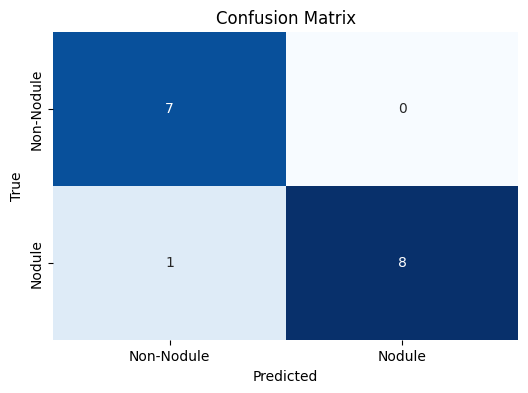

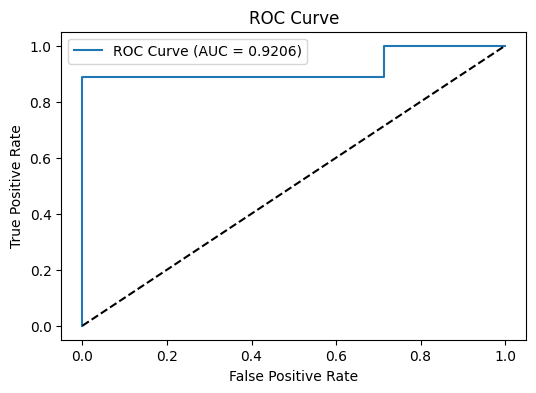

In [31]:
# Evaluate Nodule Detection Model
def evaluate_nodule_cnn(model, test_loader, device):
    model.eval()
    test_preds, test_true, test_probs = [], [], []
    with torch.no_grad():
        for patches, labels in test_loader:
            patches, labels = patches.to(device), labels.float().to(device)
            outputs = model(patches).squeeze()
            preds = (outputs > 0.5).float()
            
            # Ensure preds, labels, and outputs are iterable
            if outputs.dim() == 0:  # Single scalar (batch size 1)
                test_preds.append(preds.cpu().numpy().item())
                test_true.append(labels.cpu().numpy().item())
                test_probs.append(outputs.cpu().numpy().item())
            else:  # Batch with multiple samples
                test_preds.extend(preds.cpu().numpy())
                test_true.extend(labels.cpu().numpy())
                test_probs.extend(outputs.cpu().numpy())

    accuracy = (np.array(test_preds) == np.array(test_true)).mean()
    precision = precision_score(test_true, test_preds)
    recall = recall_score(test_true, test_preds)
    f1 = f1_score(test_true, test_preds)
    auc = roc_auc_score(test_true, test_probs)

    print(f"\nTest Accuracy: {accuracy:.4f}")
    print(f"Test Precision: {precision:.4f}")
    print(f"Test Recall: {recall:.4f}")
    print(f"Test F1-Score: {f1:.4f}")
    print(f"Test AUC-ROC: {auc:.4f}")

    # Confusion Matrix
    cm = confusion_matrix(test_true, test_preds)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
                xticklabels=['Non-Nodule', 'Nodule'], yticklabels=['Non-Nodule', 'Nodule'])
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    # ROC Curve
    from sklearn.metrics import roc_curve
    fpr, tpr, _ = roc_curve(test_true, test_probs)
    plt.figure(figsize=(6, 4))
    plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {auc:.4f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend()
    plt.show()

# Step 8: Evaluate the nodule detection model
print("\nStep 8: Evaluating nodule detection model...")
evaluate_nodule_cnn(detection_model, test_loader_det, DEVICE)

### Final Summary
This step prints a summary of the output directories.

In [32]:
# Step 9: Final summary
print("\nStep 9: Summary:")
print(f"Preprocessed data saved to: {PREPROCESSED_DIR}")
print(f"Predicted lung masks saved to: {PREDICTED_MASKS_DIR}")
print(f"Trained detection model saved to: {DETECTION_MODEL_PATH}")
print("Lung masks and nodule detection results are now ready for further analysis!")
print("Note: Model was trained on 22,178 slices for segmentation and predicted lung masks for all 89 scans.")


Step 9: Summary:
Preprocessed data saved to: /kaggle/working/luna16_subset0_preprocessed/
Predicted lung masks saved to: /kaggle/working/luna16_subset0_predicted_masks/
Trained detection model saved to: /kaggle/working/nodule_detection_cnn.pth
Lung masks and nodule detection results are now ready for further analysis!
Note: Model was trained on 22,178 slices for segmentation and predicted lung masks for all 89 scans.
